In [1]:
from google.colab import drive
drive.mount('/content/drive')

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


# Libreries

In [2]:
import os
import numpy as np
from PIL import Image
import matplotlib.pyplot as plt
import matplotlib.image as mpimg
import cv2

import torch
import torch.nn as nn
from torch.optim import SGD, AdamW
from torch.utils.data import DataLoader, Dataset, random_split
import torchvision
from torchvision import transforms
from torchvision.datasets import MNIST
from torchvision.utils import make_grid

import pytorch_lightning as pl

from skimage.metrics import peak_signal_noise_ratio as psnr, structural_similarity as ssim

device = "cuda" if torch.cuda.is_available() else "cpu"

In [3]:
def show_image(image_path):
    img = mpimg.imread(image_path)
    plt.imshow(img)
    plt.axis('off')  # Rimuove gli assi dall'immagine
    plt.show()

# Image Resizing

Al fine di adattare il set di immagini all'hardware disponibile, nonchè adattarlo ad una architettura di deep learning, di seguito viene effettuato un resizing a (256,256) di tutte le immagini contenute nella cartella "wild birds shots - Ricerca Google" ottenuta da google immagini grazie ad un plugin di chrome

In [4]:
# transform = transforms.Compose([
#     transforms.Resize((256, 256)),
#     transforms.ToTensor()
# ])

# input_folder = "wild birds shots - Ricerca Google"

# output_folder = "dataset"

# if not os.path.exists(output_folder):
#     os.makedirs(output_folder)

# image_number = 1

# for file_name in os.listdir(input_folder):
#     input_path = os.path.join(input_folder, file_name)

#     image = Image.open(input_path).convert("RGB")

#     resized_image = transform(image)

#     output_path = os.path.join(output_folder, f"{image_number}.jpg")

#     torchvision.utils.save_image(resized_image, output_path)

#     image_number += 1

# print("Operazione completata. Le immagini sono state ridimensionate e salvate nella cartella di output.")


# Adding random noise to all images

Al fine di allenare un modello Denoising AutoEncoder oltre al dataset originale è necessario avere le stesse immagini ma con del noise. Per fare ciò aggiungo del rumore gaussiano a tutte le immagini originali così da avere le immagini senza rumore da usare per il calcolo della loss function e le immagini con rumore come input del modello.

Nello specifico saranno creati due nuovi dataset al fine di distinguere due tipologie di rumore comuni in fotografia:
- Rumore cromatico
- Rumore luminanza

In [5]:
# Livello di rumore
noise_level = 0.05  # Puoi variare questo valore per aumentare o diminuire il rumore

## Chromatic noise

In [6]:
import os
import numpy as np
from PIL import Image

def add_chromatic_noise(image, noise_level=0.1):
    """
    Aggiunge rumore cromatico a un'immagine RGB.

    :param image: Immagine RGB come oggetto PIL.Image.
    :param noise_level: Livello di rumore (0-1), dove 0 è senza rumore e 1 è rumore massimo.
    :return: Immagine con rumore cromatico aggiunto come oggetto PIL.Image.
    """
    # Converti l'immagine in un array numpy
    image_array = np.array(image).astype(np.float32) / 255.0

    # Genera rumore cromatico
    noise = np.random.normal(scale=noise_level, size=image_array.shape)

    # Aggiungi il rumore all'immagine
    noisy_image = image_array + noise

    # Clippa i valori per essere nell'intervallo [0, 1]
    noisy_image = np.clip(noisy_image, 0.0, 1.0)

    # Converti di nuovo in formato immagine PIL
    noisy_image = (noisy_image * 255).astype(np.uint8)
    noisy_image = Image.fromarray(noisy_image)

    return noisy_image

# Percorsi delle cartelle
input_folder = "/content/drive/MyDrive/dataset"
output_folder = "/content/drive/MyDrive/dataset_chromatic_noise"

# Crea la cartella di output se non esiste
if not os.path.exists(output_folder):
    os.makedirs(output_folder)

# Lista dei file nella cartella di input
file_list = os.listdir(input_folder)

# Processo per aggiungere rumore cromatico alle immagini
for file_name in file_list:
    input_path = os.path.join(input_folder, file_name)
    image = Image.open(input_path).convert('RGB')
    noisy_image = add_chromatic_noise(image, noise_level)
    output_path = os.path.join(output_folder, f"{file_name}")
    noisy_image.save(output_path)

print("Operazione completata. Le immagini con rumore aggiunto sono state salvate nella cartella di output.")

Operazione completata. Le immagini con rumore aggiunto sono state salvate nella cartella di output.


## Luminance Noise

In [7]:
import os
import numpy as np
from PIL import Image

def add_luminance_noise(image, noise_level=0.1):
    """
    Aggiunge rumore luminoso a un'immagine RGB.

    :param image: Immagine RGB come oggetto PIL.Image.
    :param noise_level: Livello di rumore (0-1), dove 0 è senza rumore e 1 è rumore massimo.
    :return: Immagine con rumore luminoso aggiunto come oggetto PIL.Image.
    """
    # Converti l'immagine in un array numpy
    image_array = np.array(image).astype(np.float32) / 255.0

    # Genera rumore luminoso
    noise = np.random.normal(scale=noise_level, size=image_array.shape[:2])
    noise = np.expand_dims(noise, axis=-1)

    # Aggiungi il rumore all'immagine
    noisy_image = image_array + noise

    # Clippa i valori per essere nell'intervallo [0, 1]
    noisy_image = np.clip(noisy_image, 0.0, 1.0)

    # Converti di nuovo in formato immagine PIL
    noisy_image = (noisy_image * 255).astype(np.uint8)
    noisy_image = Image.fromarray(noisy_image)

    return noisy_image

# Percorsi delle cartelle
input_folder = "/content/drive/MyDrive/dataset"
output_folder = "/content/drive/MyDrive/dataset_luminance_noise"

# Crea la cartella di output se non esiste
if not os.path.exists(output_folder):
    os.makedirs(output_folder)

# Lista dei file nella cartella di input
file_list = os.listdir(input_folder)

# Processo per aggiungere rumore luminoso alle immagini
for file_name in file_list:
    input_path = os.path.join(input_folder, file_name)
    image = Image.open(input_path).convert('RGB')
    noisy_image = add_luminance_noise(image, noise_level)
    output_path = os.path.join(output_folder, f"{file_name}")
    noisy_image.save(output_path)

print("Operazione completata. Le immagini con rumore aggiunto sono state salvate nella cartella di output.")

Operazione completata. Le immagini con rumore aggiunto sono state salvate nella cartella di output.


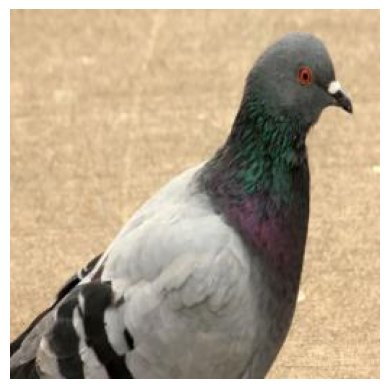

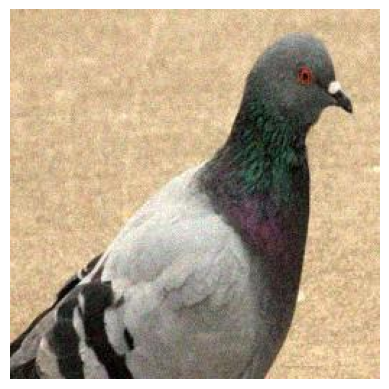

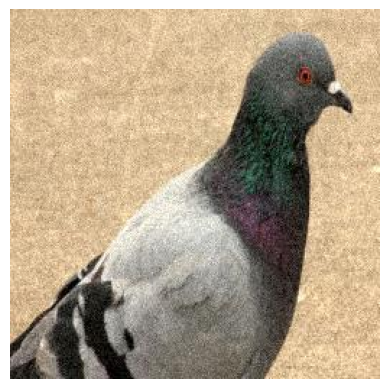

In [8]:
show_image("/content/drive/MyDrive/dataset/4.jpg")
show_image("/content/drive/MyDrive/dataset_chromatic_noise/4.jpg")
show_image("/content/drive/MyDrive/dataset_luminance_noise/4.jpg")

# Utility functions

In [9]:
def calculate_psnr(image1, image2):
    # Convert images to numpy arrays and scale to [0, 1]
    image1_np = image1.cpu().numpy().transpose(1, 2, 0)
    image2_np = image2.cpu().numpy().transpose(1, 2, 0)
    image1_np = (image1_np - image1_np.min()) / (image1_np.max() - image1_np.min())
    image2_np = (image2_np - image2_np.min()) / (image2_np.max() - image2_np.min())

    return psnr(image1_np, image2_np, data_range=1.0)

def calculate_ssim(image1, image2):
    # Convert images to numpy arrays and scale to [0, 1]
    image1_np = image1.cpu().numpy().transpose(1, 2, 0)
    image2_np = image2.cpu().numpy().transpose(1, 2, 0)
    image1_np = (image1_np - image1_np.min()) / (image1_np.max() - image1_np.min())
    image2_np = (image2_np - image2_np.min()) / (image2_np.max() - image2_np.min())

    return ssim(image1_np, image2_np, data_range=1.0, multichannel=True, win_size=3, channel_axis=-1)

def show_images(model, size):
    titles = ['Clear Images', 'Perturbed Images', 'Reconstructed Images']
    image_groups = [model.validation_results['inputs'],
                    model.validation_results['perturbed'],
                    model.validation_results['outputs']]

    clear_images = model.validation_results['inputs']
    perturbed_images = model.validation_results['perturbed']
    reconstructed_images = model.validation_results['outputs']

    # Calculate PSNR and SSIM
    psnr_noisy = np.mean([calculate_psnr(clear, noisy) for clear, noisy in zip(clear_images, perturbed_images)])
    psnr_reconstructed = np.mean([calculate_psnr(clear, reconstructed) for clear, reconstructed in zip(clear_images, reconstructed_images)])

    ssim_noisy = np.mean([calculate_ssim(clear, noisy) for clear, noisy in zip(clear_images, perturbed_images)])
    ssim_reconstructed = np.mean([calculate_ssim(clear, reconstructed) for clear, reconstructed in zip(clear_images, reconstructed_images)])

    print(f"Average PSNR between clear and perturbed images: {psnr_noisy:.2f} dB")
    print(f"Average PSNR between clear and reconstructed images: {psnr_reconstructed:.2f} dB")
    print(f"Average SSIM between clear and perturbed images: {ssim_noisy:.4f}")
    print(f"Average SSIM between clear and reconstructed images: {ssim_reconstructed:.4f}")

    for images, title in zip(image_groups, titles):
        images = torchvision.utils.make_grid(images.view(-1, 3, size, size)[:5, ...], nrow=5, normalize=True)
        images_np = images.permute(1, 2, 0).cpu().numpy()

        plt.figure(figsize=(15, 15))
        plt.title(title)
        plt.imshow(images_np)
        plt.axis('off')
        plt.show()

In [10]:
import torch
from torch.utils.data import Dataset, DataLoader, random_split, ConcatDataset
from torchvision import transforms
from PIL import Image
import os

class NoisyImageDataset(Dataset):
    def __init__(self, clean_dir, noisy_dir, transform=None):
        self.clean_dir = clean_dir
        self.noisy_dir = noisy_dir
        self.transform = transform
        self.clean_images = os.listdir(clean_dir)
        self.noisy_images = os.listdir(noisy_dir)

    def __len__(self):
        return len(self.clean_images)

    def __getitem__(self, idx):
        clean_img_path = os.path.join(self.clean_dir, self.clean_images[idx])
        noisy_img_path = os.path.join(self.noisy_dir, self.noisy_images[idx])
        clean_image = Image.open(clean_img_path).convert("RGB")
        noisy_image = Image.open(noisy_img_path).convert("RGB")

        if self.transform:
            clean_image = self.transform(clean_image)
            noisy_image = self.transform(noisy_image)

        return noisy_image, clean_image

In [11]:
size = 128
# Trasformazione delle immagini
transform = transforms.Compose([
    transforms.ToTensor(),
    transforms.Resize((size, size)),
])

# Directory delle immagini pulite e rumorose
clean_dir = '/content/drive/MyDrive/dataset'
luminance_noisy_dir = '/content/drive/MyDrive/dataset_luminance_noise'
chromatic_noisy_dir = '/content/drive/MyDrive/dataset_chromatic_noise'

# Creazione del dataset
luminance_dataset = NoisyImageDataset(clean_dir, luminance_noisy_dir, transform=transform)

chromatic_dataset = NoisyImageDataset(clean_dir, chromatic_noisy_dir, transform=transform)

dataset = ConcatDataset([luminance_dataset, chromatic_dataset])

# Suddivisione del dataset in train e validation set (80% train, 20% val)
train_size = int(0.8 * len(dataset))
val_size = len(dataset) - train_size
train_dataset, val_dataset = random_split(dataset, [train_size, val_size])

# Creazione dei dataloader per train e val
train_dataloader = DataLoader(train_dataset, batch_size=64, shuffle=True, num_workers=6, persistent_workers=True)
val_dataloader = DataLoader(val_dataset, batch_size=64, shuffle=False, num_workers=6, persistent_workers=True)

/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py:558: UserWarning: This DataLoader will create 6 worker processes in total. Our suggested max number of worker in current system is 2, which is smaller than what this DataLoader is going to create. Please be aware that excessive worker creation might get DataLoader running slow or even freeze, lower the worker number to avoid potential slowness/freeze if necessary.
  warnings.warn(_create_warning_msg(


# Experiments luminance noise

Di seguito verranno condotti diversi esperimenti modificando di volta in volta l'architettura del modello al fine di migliorarlo.

## Experiment 1

In [12]:
class DenoisingConvAutoencoder(pl.LightningModule):
    def __init__(self):
        self.validation_results = {
            'inputs': [],
            'perturbed': [],
            'outputs': []
        }
        self.train_step_losses = []
        self.val_step_losses = []
        self.train_losses = []
        self.val_losses = []

        super(DenoisingConvAutoencoder, self).__init__()

        self.encoder = nn.Sequential(
            nn.Conv2d(3, 8, kernel_size=3, stride=1, padding=1),
            nn.SiLU(),
            nn.AvgPool2d(kernel_size=2, stride=2),
            nn.Conv2d(8, 16, kernel_size=3, stride=1, padding=1),
            nn.SiLU(),
            nn.AvgPool2d(kernel_size=2, stride=2),
            nn.Conv2d(16, 32, kernel_size=3, stride=1, padding=1),
            nn.SiLU(),
        )
        self.decoder = nn.Sequential(
            nn.ConvTranspose2d(32, 16, 3, stride=2, padding=1, output_padding=1),
            nn.SiLU(),
            nn.ConvTranspose2d(16, 8, 3, stride=2, padding=1, output_padding=1),
            nn.SiLU(),
            nn.Conv2d(8, 3, kernel_size=3, stride=1, padding=1),
        )
        self.criterion = nn.MSELoss()

    def forward(self, x):
        code = self.encoder(x)
        reconstructed = self.decoder(code)
        return code, reconstructed

    def configure_optimizers(self):
        optimizer = AdamW(self.parameters(), lr = 1e-4, weight_decay=1e-3)
        return optimizer

    def training_step(self, train_batch, batch_idx):
        x_noisy, x_clean = train_batch
        _, reconstructed = self.forward(x_noisy)
        loss = self.criterion(x_clean, reconstructed)
        self.log('train/loss', loss, prog_bar=True)
        self.train_step_losses.append(loss.item())
        return loss

    def on_train_epoch_end(self):
        print()
        self.train_losses.append(self.train_step_losses[-1])

    def validation_step(self, val_batch, batch_idx):
        x_noisy, x_clean = val_batch
        _, reconstructed = self.forward(x_noisy)
        loss = self.criterion(x_clean, reconstructed)
        self.log('val/loss', loss, prog_bar=True)
        self.val_step_losses.append(loss.item())

        self.validation_results['inputs'] = x_clean
        self.validation_results['perturbed'] = x_noisy
        self.validation_results['outputs'] = reconstructed

        return loss

    def on_train_end(self):
        plt.figure(figsize=(10, 5))
        plt.plot(self.train_losses, label='Training Loss')
        plt.plot(self.val_losses[1:], label='Validation Loss')
        plt.xlabel('Epoch')
        plt.ylabel('Loss')
        plt.title('Training and Validation Loss')
        # plt.legend()
        plt.show()

        torch.save(self.state_dict(), 'denoising_conv_autoencoder_v1.pth')

    def on_validation_epoch_end(self):
        self.val_losses.append(min(self.val_step_losses))

INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
INFO:pytorch_lightning.callbacks.model_summary:
  | Name      | Type       | Params | Mode 
-------------------------------------------------
0 | encoder   | Sequential | 6.0 K  | train
1 | decoder   | Sequential | 6.0 K  | train
2 | criterion | MSELoss    | 0      | train
-------------------------------------------------
12.0 K    Trainable params
0         Non-trainable params
12.0 K    Total params
0.048     Total estimated model params size (MB)


Sanity Checking: |          | 0/? [00:00<?, ?it/s]

/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py:558: UserWarning: This DataLoader will create 6 worker processes in total. Our suggested max number of worker in current system is 2, which is smaller than what this DataLoader is going to create. Please be aware that excessive worker creation might get DataLoader running slow or even freeze, lower the worker number to avoid potential slowness/freeze if necessary.
  warnings.warn(_create_warning_msg(
/usr/lib/python3.10/multiprocessing/popen_fork.py:66: RuntimeWarning: os.fork() was called. os.fork() is incompatible with multithreaded code, and JAX is multithreaded, so this will likely lead to a deadlock.
  self.pid = os.fork()
/usr/local/lib/python3.10/dist-packages/pytorch_lightning/loops/fit_loop.py:298: The number of training batches (16) is smaller than the logging interval Trainer(log_every_n_steps=50). Set a lower value for log_every_n_steps if you want to see logs for the training epoch.


Training: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:`Trainer.fit` stopped: `max_epochs=50` reached.



[0.29334160685539246, 0.26227426528930664, 0.2557244896888733, 0.24893467128276825, 0.24141307175159454, 0.23218555748462677, 0.21886394917964935, 0.19698350131511688, 0.15968921780586243, 0.10286496579647064, 0.05067804455757141, 0.04073663428425789, 0.03382463753223419, 0.031327761709690094, 0.029850497841835022, 0.02881799265742302, 0.028089359402656555, 0.027509726583957672, 0.027036190032958984, 0.026647429913282394, 0.02630498632788658, 0.026001285761594772, 0.025765037164092064, 0.025555606931447983, 0.02534414641559124, 0.025136053562164307, 0.024946242570877075, 0.024791982024908066, 0.024593621492385864, 0.024457981809973717, 0.0243242047727108, 0.02416670322418213, 0.024011103436350822, 0.023865943774580956, 0.0237339548766613, 0.02359587699174881, 0.02344522997736931, 0.023327209055423737, 0.023198992013931274, 0.02306811325252056, 0.022937191650271416, 0.02282431721687317, 0.022704994305968285, 0.02257724478840828, 0.022469617426395416, 0.022351782768964767, 0.02220853976

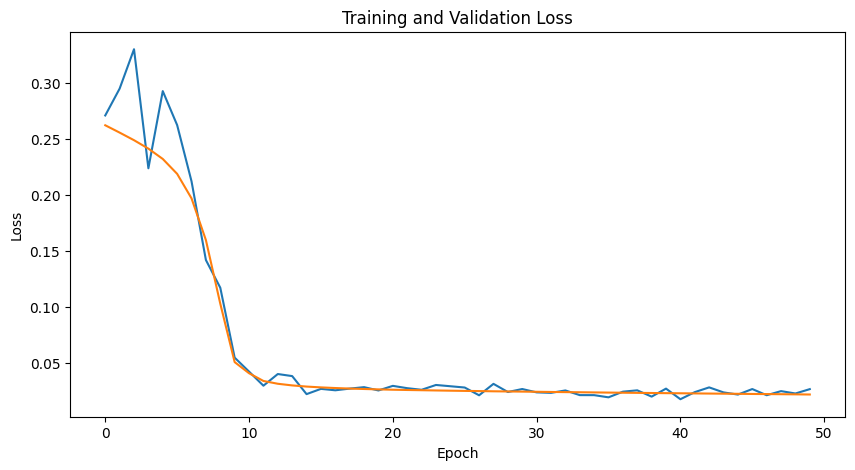

In [13]:
autoencoder = DenoisingConvAutoencoder()

trainer = pl.Trainer(max_epochs=50)

trainer.fit(autoencoder, train_dataloader, val_dataloader)

<ipython-input-9-fbe845342f23>:17: FutureWarning: `multichannel` is a deprecated argument name for `structural_similarity`. It will be removed in version 1.0. Please use `channel_axis` instead.
  return ssim(image1_np, image2_np, data_range=1.0, multichannel=True, win_size=3, channel_axis=-1)


Average PSNR between clear and perturbed images: 36.02 dB
Average PSNR between clear and reconstructed images: 15.25 dB
Average SSIM between clear and perturbed images: 0.9170
Average SSIM between clear and reconstructed images: 0.4238


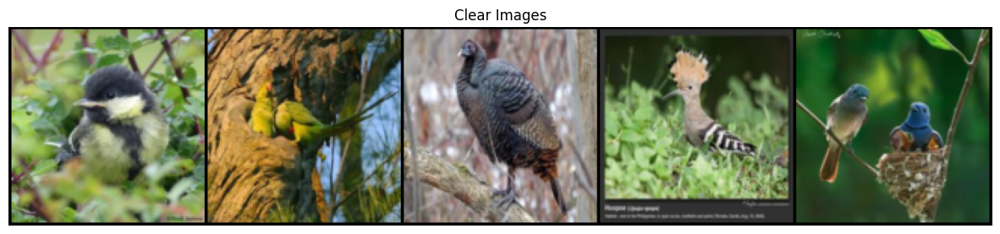

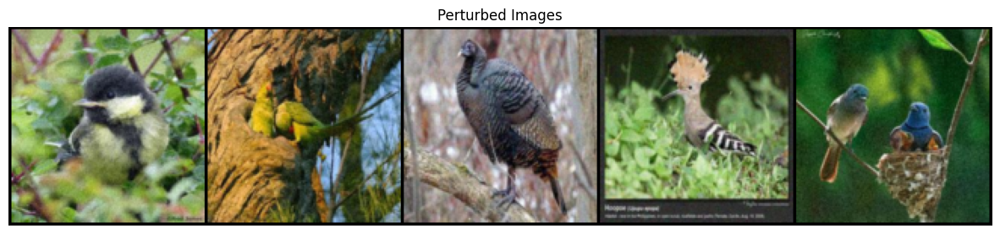

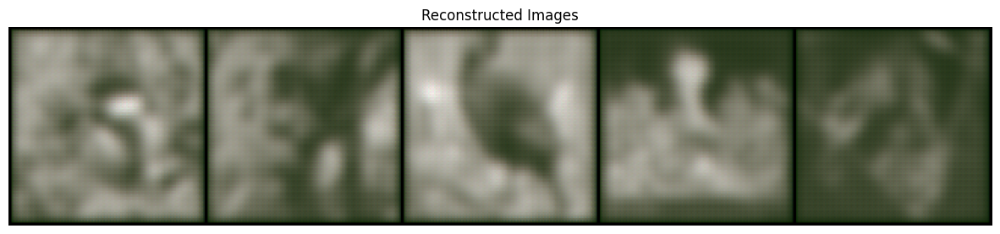

In [14]:
# Dopo aver addestrato il modello, visualizza le immagini
show_images(autoencoder,size)


# Experiment 2

In [15]:
class DenoisingConvAutoencoder(pl.LightningModule):
    def __init__(self):
        self.validation_results = {
            'inputs': [],
            'perturbed': [],
            'outputs': []
        }
        self.train_step_losses = []
        self.val_step_losses = []
        self.train_losses = []
        self.val_losses = []

        super(DenoisingConvAutoencoder, self).__init__()
        # Encoder

        self.encoder = nn.Sequential(
            nn.Conv2d(3, 8, kernel_size=3, stride=1, padding=1),
            nn.SiLU(),
            nn.AvgPool2d(kernel_size=2, stride=2),
            nn.Conv2d(8, 16, kernel_size=3, stride=1, padding=1),
            nn.SiLU(),
            nn.AvgPool2d(kernel_size=2, stride=2),
            nn.Conv2d(16, 32, kernel_size=3, stride=1, padding=1),
            nn.SiLU(),
            nn.AvgPool2d(kernel_size=2, stride=2),
            nn.Conv2d(32, 64, kernel_size=3, stride=1, padding=1),
            nn.SiLU(),
            nn.AvgPool2d(kernel_size=2, stride=2),
            nn.Conv2d(64, 128, kernel_size=3, stride=1, padding=1),
            nn.SiLU(),
        )
        self.decoder = nn.Sequential(
            nn.ConvTranspose2d(128, 64, 3, stride=2, padding=1, output_padding=1),
            nn.SiLU(),
            nn.ConvTranspose2d(64, 32, 3, stride=2, padding=1, output_padding=1),
            nn.SiLU(),
            nn.ConvTranspose2d(32, 16, 3, stride=2, padding=1, output_padding=1),
            nn.SiLU(),
            nn.ConvTranspose2d(16, 8, 3, stride=2, padding=1, output_padding=1),
            nn.SiLU(),
            nn.Conv2d(8, 3, kernel_size=3, stride=1, padding=1),
        )
        self.criterion = nn.MSELoss()

    def forward(self, x):
        code = self.encoder(x)
        reconstructed = self.decoder(code)
        return code, reconstructed

    def configure_optimizers(self):
        # optimizer = SGD(self.parameters(), lr=0.01, momentum=0.99)
        optimizer = AdamW(self.parameters(), lr = 1e-4, weight_decay=1e-3)
        return optimizer

    def training_step(self, train_batch, batch_idx):
        x_noisy, x_clean = train_batch
        _, reconstructed = self.forward(x_noisy)
        loss = self.criterion(x_clean, reconstructed)
        self.log('train/loss', loss, prog_bar=True)
        self.train_step_losses.append(loss.item())
        return loss

    def on_train_epoch_end(self):
        print()
        self.train_losses.append(self.train_step_losses[-1])

    def validation_step(self, val_batch, batch_idx):
        x_noisy, x_clean = val_batch
        _, reconstructed = self.forward(x_noisy)
        loss = self.criterion(x_clean, reconstructed)
        self.log('val/loss', loss, prog_bar=True)
        self.val_step_losses.append(loss.item())

        self.validation_results['inputs'] = x_clean
        self.validation_results['perturbed'] = x_noisy
        self.validation_results['outputs'] = reconstructed

        return loss

    def on_train_end(self):
        print(self.val_losses)
        plt.figure(figsize=(10, 5))
        plt.plot(self.train_losses, label='Training Loss')
        plt.plot(self.val_losses[1:], label='Validation Loss')
        plt.xlabel('Epoch')
        plt.ylabel('Loss')
        plt.title('Training and Validation Loss')
        # plt.legend()
        plt.show()

        torch.save(self.state_dict(), 'denoising_conv_autoencoder_v2.pth')

    def on_validation_epoch_end(self):
        self.val_losses.append(min(self.val_step_losses))

INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
INFO:pytorch_lightning.callbacks.model_summary:
  | Name      | Type       | Params | Mode 
-------------------------------------------------
0 | encoder   | Sequential | 98.4 K | train
1 | decoder   | Sequential | 98.3 K | train
2 | criterion | MSELoss    | 0      | train
-------------------------------------------------
196 K     Trainable params
0         Non-trainable params
196 K     Total params
0.787     Total estimated model params size (MB)


Sanity Checking: |          | 0/? [00:00<?, ?it/s]

Training: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:`Trainer.fit` stopped: `max_epochs=50` reached.



[0.2507098913192749, 0.22399334609508514, 0.2170732468366623, 0.20955900847911835, 0.1978304237127304, 0.153239443898201, 0.10361013561487198, 0.08376548439264297, 0.07216459512710571, 0.06376367807388306, 0.057663749903440475, 0.0530325323343277, 0.04968959093093872, 0.047166626900434494, 0.045109331607818604, 0.043448977172374725, 0.04205602407455444, 0.040767744183540344, 0.039565473794937134, 0.038378506898880005, 0.037213075906038284, 0.03593417629599571, 0.03466712310910225, 0.03329261392354965, 0.031852081418037415, 0.03031122498214245, 0.02862696349620819, 0.02691660076379776, 0.02552473545074463, 0.02467181906104088, 0.02416546642780304, 0.023832019418478012, 0.02352355420589447, 0.02324565127491951, 0.023024391382932663, 0.022805621847510338, 0.02263198047876358, 0.022466357797384262, 0.022321676835417747, 0.022202253341674805, 0.02205866575241089, 0.021931132301688194, 0.02185054123401642, 0.02174055203795433, 0.021604720503091812, 0.021502193063497543, 0.021394550800323486

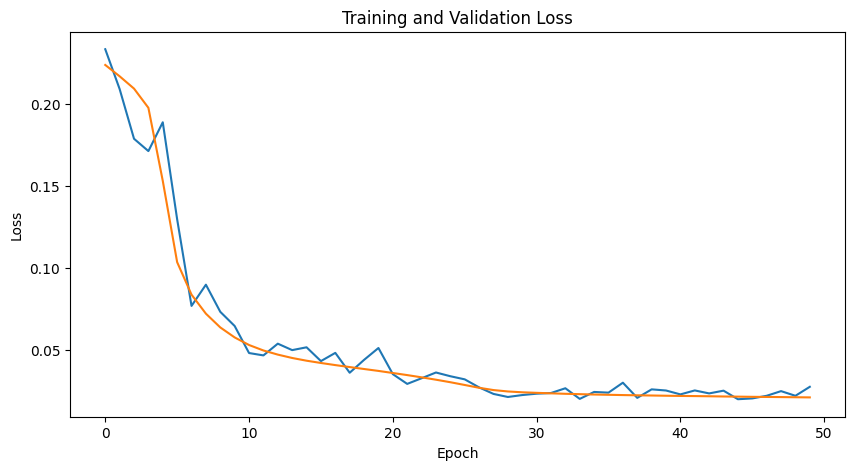

In [16]:
autoencoder = DenoisingConvAutoencoder()

trainer = pl.Trainer(max_epochs=50)

trainer.fit(autoencoder, train_dataloader, val_dataloader)

<ipython-input-9-fbe845342f23>:17: FutureWarning: `multichannel` is a deprecated argument name for `structural_similarity`. It will be removed in version 1.0. Please use `channel_axis` instead.
  return ssim(image1_np, image2_np, data_range=1.0, multichannel=True, win_size=3, channel_axis=-1)


Average PSNR between clear and perturbed images: 36.02 dB
Average PSNR between clear and reconstructed images: 14.79 dB
Average SSIM between clear and perturbed images: 0.9170
Average SSIM between clear and reconstructed images: 0.3797


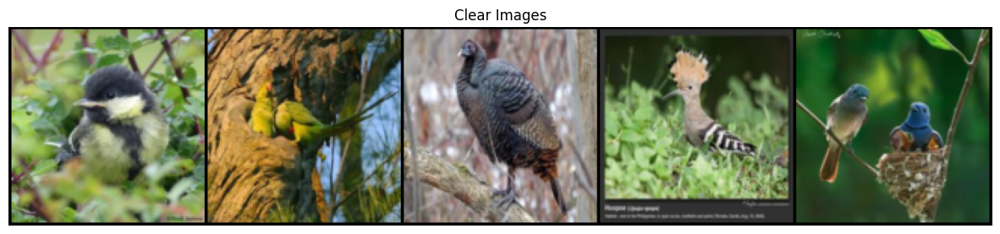

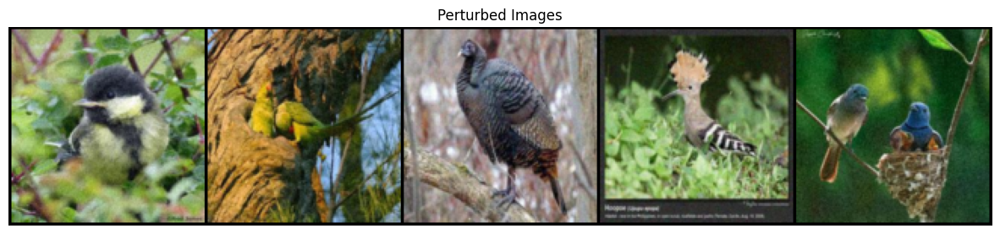

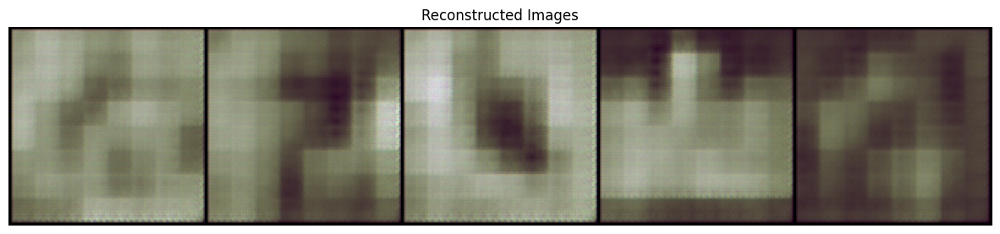

In [17]:
show_images(autoencoder,size)

# Experiment 3

In [18]:
class DenoisingConvAutoencoder(pl.LightningModule):
    def __init__(self):
        self.validation_results = {
            'inputs': [],
            'perturbed': [],
            'outputs': []
        }
        self.train_step_losses = []
        self.val_step_losses = []
        self.train_losses = []
        self.val_losses = []

        super(DenoisingConvAutoencoder, self).__init__()
        # Encoder

        self.encoder = nn.Sequential(
            nn.Conv2d(3, 8, kernel_size=3, stride=1, padding=1),
            nn.SiLU(),
            nn.AvgPool2d(kernel_size=2, stride=2),
            nn.Conv2d(8, 16, kernel_size=3, stride=1, padding=1),
            nn.SiLU(),
            nn.AvgPool2d(kernel_size=2, stride=2),
            nn.Conv2d(16, 32, kernel_size=3, stride=1, padding=1),
            nn.SiLU(),
            nn.AvgPool2d(kernel_size=2, stride=2),
            nn.Conv2d(32, 64, kernel_size=3, stride=1, padding=1),
            nn.SiLU(),
            nn.AvgPool2d(kernel_size=2, stride=2),
            nn.Conv2d(64, 128, kernel_size=3, stride=1, padding=1),
            nn.SiLU(),
            nn.AvgPool2d(kernel_size=2, stride=2),
            nn.Conv2d(128, 256, kernel_size=3, stride=1, padding=1),
            nn.SiLU(),
        )
        self.decoder = nn.Sequential(
            nn.ConvTranspose2d(256, 128, 3, stride=2, padding=1, output_padding=1),
            nn.SiLU(),
            nn.ConvTranspose2d(128, 64, 3, stride=2, padding=1, output_padding=1),
            nn.SiLU(),
            nn.ConvTranspose2d(64, 32, 3, stride=2, padding=1, output_padding=1),
            nn.SiLU(),
            nn.ConvTranspose2d(32, 16, 3, stride=2, padding=1, output_padding=1),
            nn.SiLU(),
            nn.ConvTranspose2d(16, 8, 3, stride=2, padding=1, output_padding=1),
            nn.SiLU(),
            nn.Conv2d(8, 3, kernel_size=3, stride=1, padding=1),
        )
        self.criterion = nn.MSELoss()

    def forward(self, x):
        code = self.encoder(x)
        reconstructed = self.decoder(code)
        return code, reconstructed

    def configure_optimizers(self):
        # optimizer = SGD(self.parameters(), lr=0.01, momentum=0.99)
        optimizer = AdamW(self.parameters(), lr = 1e-4, weight_decay=1e-3)
        return optimizer

    def training_step(self, train_batch, batch_idx):
        x_noisy, x_clean = train_batch
        _, reconstructed = self.forward(x_noisy)
        loss = self.criterion(x_clean, reconstructed)
        self.log('train/loss', loss, prog_bar=True)
        self.train_step_losses.append(loss.item())
        return loss

    def on_train_epoch_end(self):
        self.train_losses.append(self.train_step_losses[-1])

    def validation_step(self, val_batch, batch_idx):
        x_noisy, x_clean = val_batch
        _, reconstructed = self.forward(x_noisy)
        loss = self.criterion(x_clean, reconstructed)
        self.log('val/loss', loss, prog_bar=True)
        self.val_step_losses.append(loss.item())

        self.validation_results['inputs'] = x_clean
        self.validation_results['perturbed'] = x_noisy
        self.validation_results['outputs'] = reconstructed

        return loss

    def on_train_end(self):
        plt.figure(figsize=(10, 5))
        plt.plot(self.train_losses, label='Training Loss')
        plt.plot(self.val_losses[1:], label='Validation Loss')
        plt.xlabel('Epoch')
        plt.ylabel('Loss')
        plt.title('Training and Validation Loss')
        # plt.legend()
        plt.show()

        torch.save(self.state_dict(), 'denoising_conv_autoencoder_v3.pth')

    def on_validation_epoch_end(self):
        self.val_losses.append(min(self.val_step_losses))

INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
INFO:pytorch_lightning.callbacks.model_summary:
  | Name      | Type       | Params | Mode 
-------------------------------------------------
0 | encoder   | Sequential | 393 K  | train
1 | decoder   | Sequential | 393 K  | train
2 | criterion | MSELoss    | 0      | train
-------------------------------------------------
786 K     Trainable params
0         Non-trainable params
786 K     Total params
3.147     Total estimated model params size (MB)


Sanity Checking: |          | 0/? [00:00<?, ?it/s]

Training: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:`Trainer.fit` stopped: `max_epochs=50` reached.



[0.2687319219112396, 0.24010303616523743, 0.23354041576385498, 0.22677524387836456, 0.21910281479358673, 0.19720086455345154, 0.1309375762939453, 0.0943177342414856, 0.07820164412260056, 0.06747488677501678, 0.06106998026371002, 0.05655136704444885, 0.053410112857818604, 0.05088042840361595, 0.04842646047472954, 0.0462961420416832, 0.04423251748085022, 0.0422600619494915, 0.040353335440158844, 0.03848842531442642, 0.03626774623990059, 0.03414998576045036, 0.03193740174174309, 0.030469849705696106, 0.029652517288923264, 0.029141640290617943, 0.028791671618819237, 0.028370745480060577, 0.028119605034589767, 0.027904842048883438, 0.027688568457961082, 0.027499042451381683, 0.02730599418282509, 0.02715541049838066, 0.027020782232284546, 0.02688068151473999, 0.026751920580863953, 0.026751920580863953, 0.026527289301156998, 0.02642638608813286, 0.026293566450476646, 0.02618180774152279, 0.02618180774152279, 0.02599964663386345, 0.02588482014834881, 0.025809936225414276, 0.025754641741514206

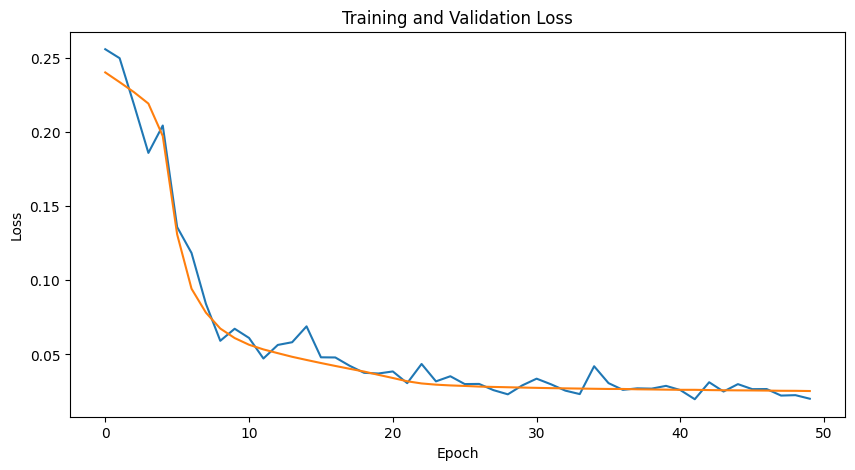

In [19]:
autoencoder = DenoisingConvAutoencoder()

trainer = pl.Trainer(max_epochs=50)

trainer.fit(autoencoder, train_dataloader, val_dataloader)

<ipython-input-9-fbe845342f23>:17: FutureWarning: `multichannel` is a deprecated argument name for `structural_similarity`. It will be removed in version 1.0. Please use `channel_axis` instead.
  return ssim(image1_np, image2_np, data_range=1.0, multichannel=True, win_size=3, channel_axis=-1)


Average PSNR between clear and perturbed images: 36.02 dB
Average PSNR between clear and reconstructed images: 13.19 dB
Average SSIM between clear and perturbed images: 0.9170
Average SSIM between clear and reconstructed images: 0.3614


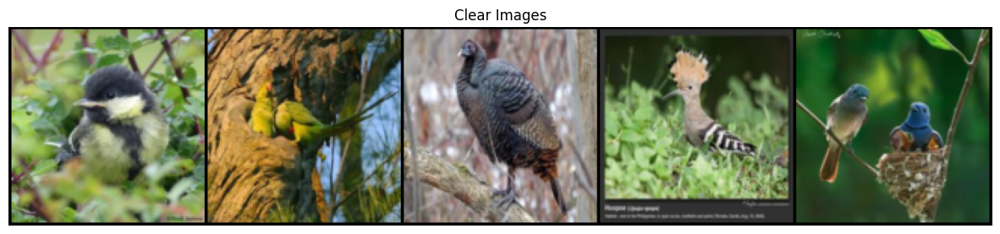

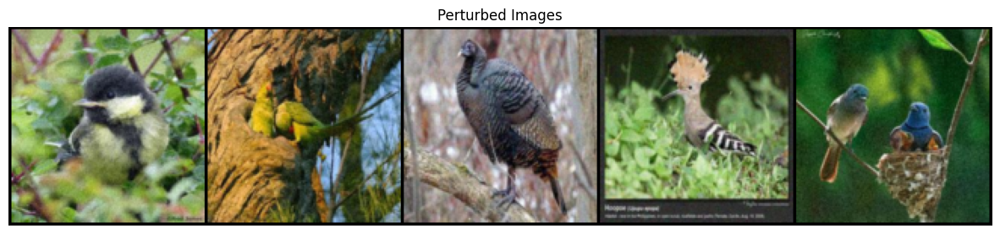

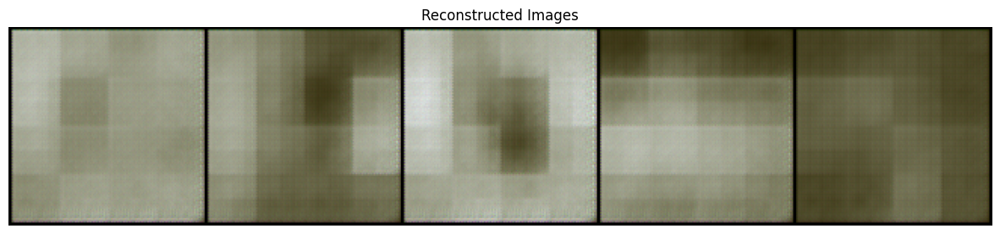

In [20]:
show_images(autoencoder,size)

## Experiment 4

In [21]:
import pytorch_lightning as pl
import torch
import torch.nn as nn
from torch.optim import AdamW
from torchvision.utils import make_grid

class DenoisingConvAutoencoder(pl.LightningModule):
    def __init__(self):
        super(DenoisingConvAutoencoder, self).__init__()
        self.validation_results = {
            'inputs': [],
            'perturbed': [],
            'outputs': []
        }
        self.train_step_losses = []
        self.val_step_losses = []
        self.train_losses = []
        self.val_losses = []

        # Encoder
        self.encoder = nn.Sequential(
            nn.Conv2d(3, 16, kernel_size=3, stride=1, padding=1),
            nn.BatchNorm2d(16),
            nn.LeakyReLU(0.2),
            nn.Conv2d(16, 32, kernel_size=3, stride=1, padding=1),
            nn.BatchNorm2d(32),
            nn.LeakyReLU(0.2),
            nn.MaxPool2d(2, 2),  # 64x64

            nn.Conv2d(32, 64, kernel_size=3, stride=1, padding=1),
            nn.BatchNorm2d(64),
            nn.LeakyReLU(0.2),
            nn.Conv2d(64, 128, kernel_size=3, stride=1, padding=1),
            nn.BatchNorm2d(128),
            nn.LeakyReLU(0.2),
            nn.MaxPool2d(2, 2),  # 32x32

            nn.Conv2d(128, 256, kernel_size=3, stride=1, padding=1),
            nn.BatchNorm2d(256),
            nn.LeakyReLU(0.2),
            nn.MaxPool2d(2, 2)  # 16x16
        )

        # Decoder
        self.decoder = nn.Sequential(
            nn.ConvTranspose2d(256, 128, kernel_size=3, stride=2, padding=1, output_padding=1),
            nn.BatchNorm2d(128),
            nn.LeakyReLU(0.2),

            nn.ConvTranspose2d(128, 64, kernel_size=3, stride=2, padding=1, output_padding=1),
            nn.BatchNorm2d(64),
            nn.LeakyReLU(0.2),

            nn.ConvTranspose2d(64, 32, kernel_size=3, stride=2, padding=1, output_padding=1),
            nn.BatchNorm2d(32),
            nn.LeakyReLU(0.2),

            nn.Conv2d(32, 16, kernel_size=3, stride=1, padding=1),
            nn.BatchNorm2d(16),
            nn.LeakyReLU(0.2),

            nn.Conv2d(16, 3, kernel_size=3, stride=1, padding=1),
            nn.Tanh()
        )

        self.criterion = nn.MSELoss()

    def forward(self, x):
        code = self.encoder(x)
        reconstructed = self.decoder(code)
        return code, reconstructed

    def configure_optimizers(self):
        optimizer = AdamW(self.parameters(), lr=1e-4, weight_decay=1e-3)
        return optimizer

    def training_step(self, train_batch, batch_idx):
        x_noisy, x_clean = train_batch
        _, reconstructed = self.forward(x_noisy)
        loss = self.criterion(x_clean, reconstructed)
        self.log('train/loss', loss, prog_bar=True)
        self.train_step_losses.append(loss.item())
        return loss

    def on_train_epoch_end(self):
        self.train_losses.append(self.train_step_losses[-1])

    def validation_step(self, val_batch, batch_idx):
        x_noisy, x_clean = val_batch
        _, reconstructed = self.forward(x_noisy)
        loss = self.criterion(x_clean, reconstructed)
        self.log('val/loss', loss, prog_bar=True)
        self.val_step_losses.append(loss.item())

        self.validation_results['inputs'] = x_clean
        self.validation_results['perturbed'] = x_noisy
        self.validation_results['outputs'] = reconstructed

        return loss

    def on_train_end(self):
        plt.figure(figsize=(10, 5))
        plt.plot(self.train_losses, label='Training Loss')
        plt.plot(self.val_losses[1:], label='Validation Loss')
        plt.xlabel('Epoch')
        plt.ylabel('Loss')
        plt.title('Training and Validation Loss')
        # plt.legend()
        plt.show()

        torch.save(self.state_dict(), 'denoising_conv_autoencoder_v4.pth')

    def on_validation_epoch_end(self):
        self.val_losses.append(min(self.val_step_losses))

INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
INFO:pytorch_lightning.callbacks.model_summary:
  | Name      | Type       | Params | Mode 
-------------------------------------------------
0 | encoder   | Sequential | 393 K  | train
1 | decoder   | Sequential | 392 K  | train
2 | criterion | MSELoss    | 0      | train
-------------------------------------------------
786 K     Trainable params
0         Non-trainable params
786 K     Total params
3.146     Total estimated model params size (MB)


Sanity Checking: |          | 0/? [00:00<?, ?it/s]

Training: |          | 0/? [00:00<?, ?it/s]

/usr/local/lib/python3.10/dist-packages/torch/autograd/graph.py:744: UserWarning: Plan failed with a cudnnException: CUDNN_BACKEND_EXECUTION_PLAN_DESCRIPTOR: cudnnFinalize Descriptor Failed cudnn_status: CUDNN_STATUS_NOT_SUPPORTED (Triggered internally at ../aten/src/ATen/native/cudnn/Conv_v8.cpp:919.)
  return Variable._execution_engine.run_backward(  # Calls into the C++ engine to run the backward pass


Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:`Trainer.fit` stopped: `max_epochs=50` reached.



[0.2758741080760956, 0.250131756067276, 0.1230364590883255, 0.048142433166503906, 0.02722943387925625, 0.018782246857881546, 0.013513276353478432, 0.011458012275397778, 0.009749761782586575, 0.009425326250493526, 0.008045059628784657, 0.007904797792434692, 0.007272168528288603, 0.006708487868309021, 0.006708487868309021, 0.006356048863381147, 0.006173537578433752, 0.005869091954082251, 0.005764644127339125, 0.005613989196717739, 0.005511037074029446, 0.005371363367885351, 0.0052467770874500275, 0.0052467770874500275, 0.005115400534123182, 0.005115400534123182, 0.004918114747852087, 0.004918114747852087, 0.004821348004043102, 0.004821348004043102, 0.004821348004043102, 0.004821348004043102, 0.004763846285641193, 0.004751583095639944, 0.004506954923272133, 0.004506954923272133, 0.004414853639900684, 0.004402495920658112, 0.004402495920658112, 0.004402495920658112, 0.004402495920658112, 0.004402495920658112, 0.004401953890919685, 0.004145389422774315, 0.004035404417663813, 0.004035404417

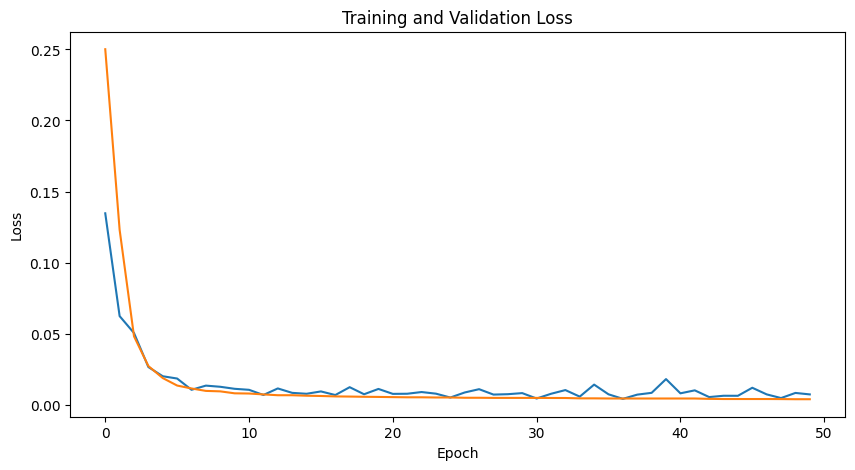

In [22]:
autoencoder = DenoisingConvAutoencoder()

trainer = pl.Trainer(max_epochs=50)

trainer.fit(autoencoder, train_dataloader, val_dataloader)

<ipython-input-9-fbe845342f23>:17: FutureWarning: `multichannel` is a deprecated argument name for `structural_similarity`. It will be removed in version 1.0. Please use `channel_axis` instead.
  return ssim(image1_np, image2_np, data_range=1.0, multichannel=True, win_size=3, channel_axis=-1)


Average PSNR between clear and perturbed images: 36.02 dB
Average PSNR between clear and reconstructed images: 20.89 dB
Average SSIM between clear and perturbed images: 0.9170
Average SSIM between clear and reconstructed images: 0.5554


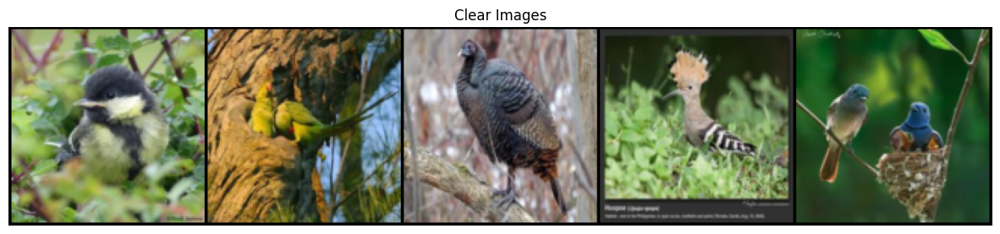

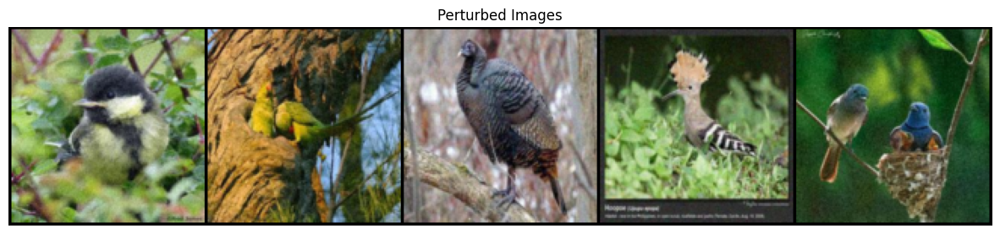

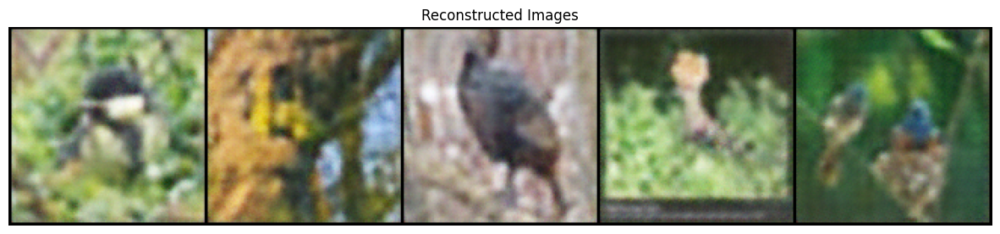

In [23]:
show_images(autoencoder,size)

## Experiment 5

In [24]:
class DenoisingConvAutoencoder(pl.LightningModule):
    def __init__(self):
        super(DenoisingConvAutoencoder, self).__init__()
        self.validation_results = {
            'inputs': [],
            'perturbed': [],
            'outputs': []
        }
        self.train_step_losses = []
        self.val_step_losses = []
        self.train_losses = []
        self.val_losses = []

        # Encoder
        self.encoder = nn.Sequential(
            nn.Conv2d(3, 16, kernel_size=3, stride=1, padding=1),
            nn.BatchNorm2d(16),
            nn.LeakyReLU(0.2),
            nn.Conv2d(16, 32, kernel_size=3, stride=1, padding=1),
            nn.BatchNorm2d(32),
            nn.LeakyReLU(0.2),
            nn.MaxPool2d(2, 2),  # 64x64

            nn.Conv2d(32, 64, kernel_size=3, stride=1, padding=1),
            nn.BatchNorm2d(64),
            nn.LeakyReLU(0.2),
            nn.Conv2d(64, 128, kernel_size=3, stride=1, padding=1),
            nn.BatchNorm2d(128),
            nn.LeakyReLU(0.2),
            nn.MaxPool2d(2, 2),  # 32x32
            nn.Conv2d(128, 128, kernel_size=3, stride=1, padding=1),
            nn.BatchNorm2d(128),
            nn.LeakyReLU(0.2),
            nn.Conv2d(128, 256, kernel_size=3, stride=1, padding=1),
            nn.BatchNorm2d(256),
            nn.LeakyReLU(0.2),
            nn.MaxPool2d(2, 2)  # 16x16
        )

        # Decoder
        self.decoder = nn.Sequential(
            nn.ConvTranspose2d(256, 128, kernel_size=3, stride=2, padding=1, output_padding=1),
            nn.BatchNorm2d(128),
            nn.LeakyReLU(0.2),
            nn.Conv2d(128, 128, kernel_size=3, stride=1, padding=1),
            nn.BatchNorm2d(128),
            nn.LeakyReLU(0.2),

            nn.ConvTranspose2d(128, 64, kernel_size=3, stride=2, padding=1, output_padding=1),
            nn.BatchNorm2d(64),
            nn.LeakyReLU(0.2),

            nn.ConvTranspose2d(64, 32, kernel_size=3, stride=2, padding=1, output_padding=1),
            nn.BatchNorm2d(32),
            nn.LeakyReLU(0.2),

            nn.Conv2d(32, 16, kernel_size=3, stride=1, padding=1),
            nn.BatchNorm2d(16),
            nn.LeakyReLU(0.2),

            nn.Conv2d(16, 3, kernel_size=3, stride=1, padding=1),
            nn.Tanh()
        )

        self.criterion = nn.MSELoss()

    def forward(self, x):
        code = self.encoder(x)
        reconstructed = self.decoder(code)
        return code, reconstructed

    def configure_optimizers(self):
        optimizer = AdamW(self.parameters(), lr=1e-4, weight_decay=1e-3)
        return optimizer

    def training_step(self, train_batch, batch_idx):
        x_noisy, x_clean = train_batch
        _, reconstructed = self.forward(x_noisy)
        loss = self.criterion(x_clean, reconstructed)
        self.log('train/loss', loss, prog_bar=True)
        self.train_step_losses.append(loss.item())
        return loss

    def on_train_epoch_end(self):
        self.train_losses.append(self.train_step_losses[-1])

    def validation_step(self, val_batch, batch_idx):
        x_noisy, x_clean = val_batch
        _, reconstructed = self.forward(x_noisy)
        loss = self.criterion(x_clean, reconstructed)
        self.log('val/loss', loss, prog_bar=True)
        self.val_step_losses.append(loss.item())

        self.validation_results['inputs'] = x_clean
        self.validation_results['perturbed'] = x_noisy
        self.validation_results['outputs'] = reconstructed

        return loss

    def on_train_end(self):
        plt.figure(figsize=(10, 5))
        plt.plot(self.train_losses, label='Training Loss')
        plt.plot(self.val_losses[1:], label='Validation Loss')
        plt.xlabel('Epoch')
        plt.ylabel('Loss')
        plt.title('Training and Validation Loss')
        # plt.legend()
        plt.show()

        torch.save(self.state_dict(), 'denoising_conv_autoencoder_v5.pth')

    def on_validation_epoch_end(self):
        self.val_losses.append(min(self.val_step_losses))

INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
INFO:pytorch_lightning.callbacks.model_summary:
  | Name      | Type       | Params | Mode 
-------------------------------------------------
0 | encoder   | Sequential | 541 K  | train
1 | decoder   | Sequential | 540 K  | train
2 | criterion | MSELoss    | 0      | train
-------------------------------------------------
1.1 M     Trainable params
0         Non-trainable params
1.1 M     Total params
4.328     Total estimated model params size (MB)


Sanity Checking: |          | 0/? [00:00<?, ?it/s]

Training: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:`Trainer.fit` stopped: `max_epochs=50` reached.



[0.2431604117155075, 0.20989665389060974, 0.13066492974758148, 0.08378010988235474, 0.05410261079668999, 0.03737478703260422, 0.02778489515185356, 0.021648071706295013, 0.01842125877737999, 0.0147877661511302, 0.013155199587345123, 0.01248145755380392, 0.010886634700000286, 0.009435570798814297, 0.008319398388266563, 0.008017012849450111, 0.007367187645286322, 0.007150309160351753, 0.006721216719597578, 0.0063697574660182, 0.0063697574660182, 0.0063697574660182, 0.006071051117032766, 0.006071051117032766, 0.006071051117032766, 0.006071051117032766, 0.00566419493407011, 0.00566419493407011, 0.00566419493407011, 0.00529102748259902, 0.00529102748259902, 0.005088568665087223, 0.005088568665087223, 0.005088568665087223, 0.005088568665087223, 0.005088568665087223, 0.005088568665087223, 0.004880053456872702, 0.004873230587691069, 0.004873230587691069, 0.004873230587691069, 0.004632306285202503, 0.004632306285202503, 0.004632306285202503, 0.004632306285202503, 0.004632306285202503, 0.0045769

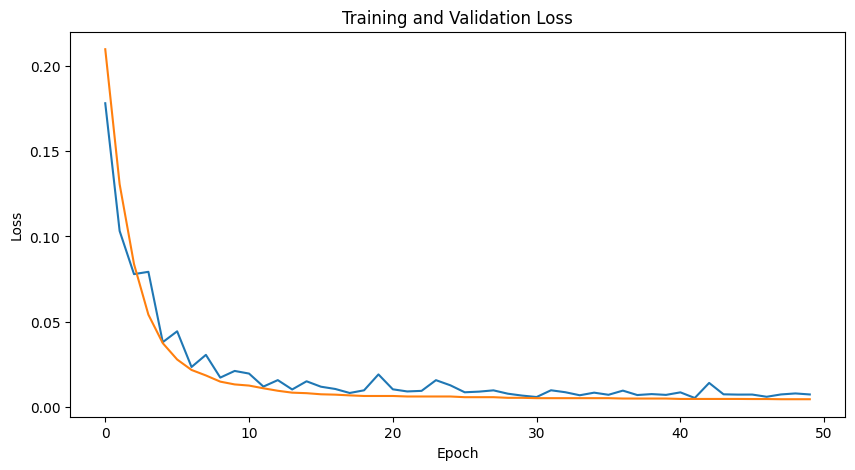

In [25]:
torch.set_float32_matmul_precision('medium')

autoencoder = DenoisingConvAutoencoder()

trainer = pl.Trainer(max_epochs=50)

trainer.fit(autoencoder, train_dataloader, val_dataloader)

<ipython-input-9-fbe845342f23>:17: FutureWarning: `multichannel` is a deprecated argument name for `structural_similarity`. It will be removed in version 1.0. Please use `channel_axis` instead.
  return ssim(image1_np, image2_np, data_range=1.0, multichannel=True, win_size=3, channel_axis=-1)


Average PSNR between clear and perturbed images: 36.02 dB
Average PSNR between clear and reconstructed images: 20.64 dB
Average SSIM between clear and perturbed images: 0.9170
Average SSIM between clear and reconstructed images: 0.5148


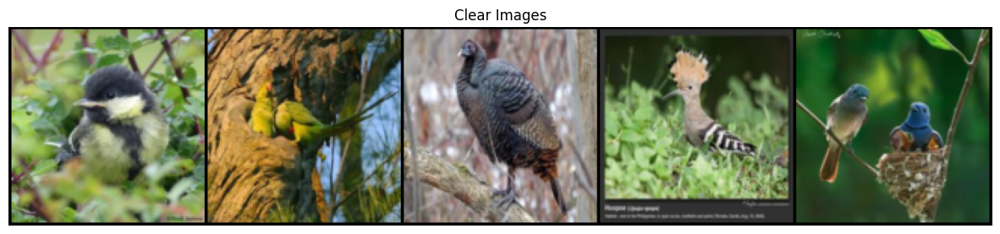

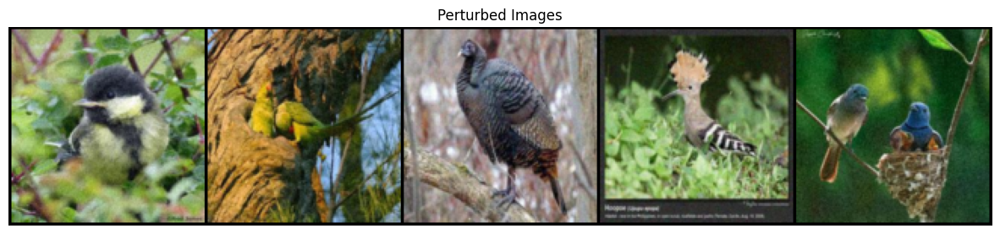

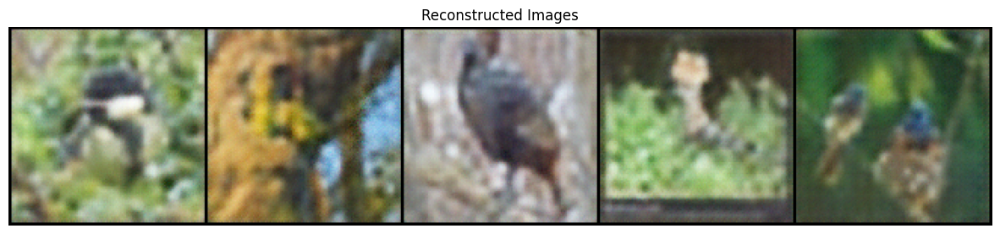

In [26]:
show_images(autoencoder, size)

## Experiment 6

In [27]:
class DenoisingConvAutoencoder(pl.LightningModule):
    def __init__(self):
        super(DenoisingConvAutoencoder, self).__init__()
        self.validation_results = {
            'inputs': [],
            'perturbed': [],
            'outputs': []
        }
        self.train_step_losses = []
        self.val_step_losses = []
        self.train_losses = []
        self.val_losses = []

        # Encoder
        self.encoder = nn.Sequential(
            nn.Conv2d(3, 16, kernel_size=3, stride=1, padding=1),
            nn.BatchNorm2d(16),
            nn.LeakyReLU(0.2),
            nn.Conv2d(16, 32, kernel_size=3, stride=1, padding=1),
            nn.BatchNorm2d(32),
            nn.LeakyReLU(0.2),
            nn.MaxPool2d(2, 2),  # 64x64

            nn.Conv2d(32, 64, kernel_size=3, stride=1, padding=1),
            nn.BatchNorm2d(64),
            nn.LeakyReLU(0.2),
            nn.Conv2d(64, 128, kernel_size=3, stride=1, padding=1),
            nn.BatchNorm2d(128),
            nn.LeakyReLU(0.2),
            nn.MaxPool2d(2, 2),  # 32x32
            nn.Conv2d(128, 128, kernel_size=3, stride=1, padding=1),
            nn.BatchNorm2d(128),
            nn.LeakyReLU(0.2),
            nn.Conv2d(128, 128, kernel_size=3, stride=1, padding=1),
            nn.BatchNorm2d(128),
            nn.LeakyReLU(0.2),
            nn.Conv2d(128, 256, kernel_size=3, stride=1, padding=1),
            nn.BatchNorm2d(256),
            nn.LeakyReLU(0.2),
            nn.MaxPool2d(2, 2)  # 16x16
        )

        # Decoder
        self.decoder = nn.Sequential(
            nn.ConvTranspose2d(256, 128, kernel_size=3, stride=2, padding=1, output_padding=1),
            nn.BatchNorm2d(128),
            nn.LeakyReLU(0.2),
            nn.Conv2d(128, 128, kernel_size=3, stride=1, padding=1),
            nn.BatchNorm2d(128),
            nn.LeakyReLU(0.2),
            nn.Conv2d(128, 128, kernel_size=3, stride=1, padding=1),
            nn.BatchNorm2d(128),
            nn.LeakyReLU(0.2),
            nn.ConvTranspose2d(128, 64, kernel_size=3, stride=2, padding=1, output_padding=1),
            nn.BatchNorm2d(64),
            nn.LeakyReLU(0.2),
            nn.ConvTranspose2d(64, 32, kernel_size=3, stride=2, padding=1, output_padding=1),
            nn.BatchNorm2d(32),
            nn.LeakyReLU(0.2),
            nn.Conv2d(32, 16, kernel_size=3, stride=1, padding=1),
            nn.BatchNorm2d(16),
            nn.LeakyReLU(0.2),
            nn.Conv2d(16, 3, kernel_size=3, stride=1, padding=1),
            nn.Tanh()
        )

        self.criterion = nn.MSELoss()

    def forward(self, x):
        code = self.encoder(x)
        reconstructed = self.decoder(code)
        return code, reconstructed

    def configure_optimizers(self):
        optimizer = AdamW(self.parameters(), lr=1e-4, weight_decay=1e-3)
        return optimizer

    def training_step(self, train_batch, batch_idx):
        x_noisy, x_clean = train_batch
        _, reconstructed = self.forward(x_noisy)
        loss = self.criterion(x_clean, reconstructed)
        self.log('train/loss', loss, prog_bar=True)
        self.train_step_losses.append(loss.item())
        return loss

    def on_train_epoch_end(self):
        self.train_losses.append(self.train_step_losses[-1])

    def validation_step(self, val_batch, batch_idx):
        x_noisy, x_clean = val_batch
        _, reconstructed = self.forward(x_noisy)
        loss = self.criterion(x_clean, reconstructed)
        self.log('val/loss', loss, prog_bar=True)
        self.val_step_losses.append(loss.item())

        self.validation_results['inputs'] = x_clean
        self.validation_results['perturbed'] = x_noisy
        self.validation_results['outputs'] = reconstructed

        return loss

    def on_train_end(self):
        plt.figure(figsize=(10, 5))
        plt.plot(self.train_losses, label='Training Loss')
        plt.plot(self.val_losses[1:], label='Validation Loss')
        plt.xlabel('Epoch')
        plt.ylabel('Loss')
        plt.title('Training and Validation Loss')
        # plt.legend()
        plt.show()

        torch.save(self.state_dict(), 'denoising_conv_autoencoder_v6.pth')

    def on_validation_epoch_end(self):
        self.val_losses.append(min(self.val_step_losses))

INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
INFO:pytorch_lightning.callbacks.model_summary:
  | Name      | Type       | Params | Mode 
-------------------------------------------------
0 | encoder   | Sequential | 689 K  | train
1 | decoder   | Sequential | 688 K  | train
2 | criterion | MSELoss    | 0      | train
-------------------------------------------------
1.4 M     Trainable params
0         Non-trainable params
1.4 M     Total params
5.511     Total estimated model params size (MB)


Sanity Checking: |          | 0/? [00:00<?, ?it/s]

Training: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:`Trainer.fit` stopped: `max_epochs=50` reached.



[0.28701648116111755, 0.2589563727378845, 0.180612713098526, 0.14412295818328857, 0.10980468988418579, 0.08595817536115646, 0.07186251878738403, 0.05571362376213074, 0.0417667031288147, 0.036670126020908356, 0.030132219195365906, 0.022827325388789177, 0.02150789275765419, 0.019347907975316048, 0.015623579733073711, 0.012133976444602013, 0.011834770441055298, 0.011834770441055298, 0.009012795053422451, 0.008433084934949875, 0.008433084934949875, 0.0074472082778811455, 0.007273803930729628, 0.007273803930729628, 0.007110857404768467, 0.0064244940876960754, 0.0059011876583099365, 0.0059011876583099365, 0.0059011876583099365, 0.0057593355886638165, 0.005484829656779766, 0.005191033706068993, 0.0050802091136574745, 0.0050802091136574745, 0.0050802091136574745, 0.004843518603593111, 0.004843518603593111, 0.004843518603593111, 0.004843518603593111, 0.004843518603593111, 0.0047318460419774055, 0.0047318460419774055, 0.0047318460419774055, 0.004450778942555189, 0.004450778942555189, 0.00445077

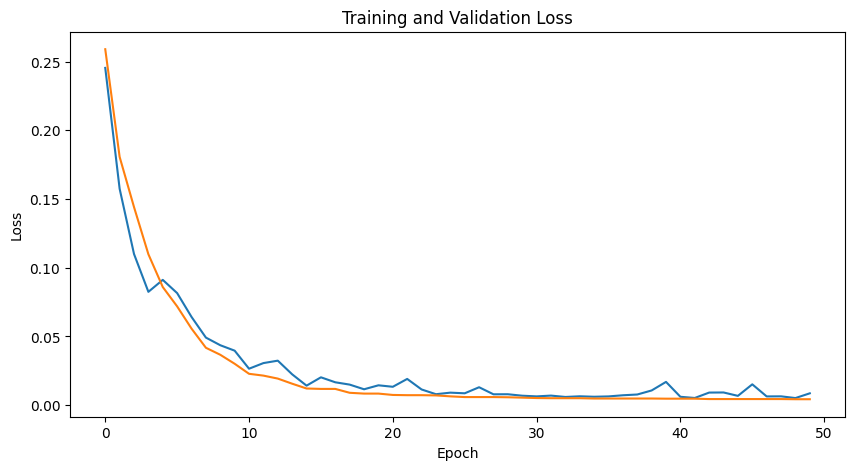

In [28]:
torch.set_float32_matmul_precision('medium')

autoencoder = DenoisingConvAutoencoder()

trainer = pl.Trainer(max_epochs=50)

trainer.fit(autoencoder, train_dataloader, val_dataloader)

<ipython-input-9-fbe845342f23>:17: FutureWarning: `multichannel` is a deprecated argument name for `structural_similarity`. It will be removed in version 1.0. Please use `channel_axis` instead.
  return ssim(image1_np, image2_np, data_range=1.0, multichannel=True, win_size=3, channel_axis=-1)


Average PSNR between clear and perturbed images: 36.02 dB
Average PSNR between clear and reconstructed images: 20.31 dB
Average SSIM between clear and perturbed images: 0.9170
Average SSIM between clear and reconstructed images: 0.5305


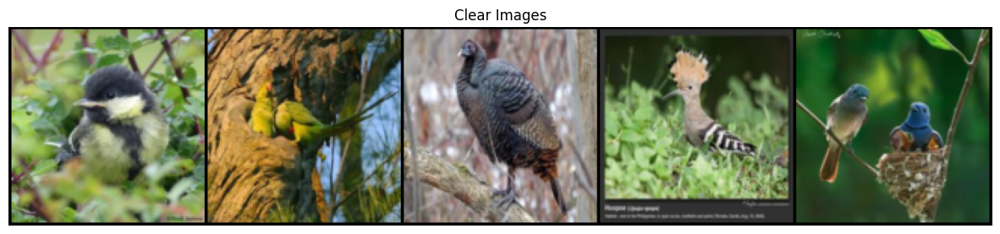

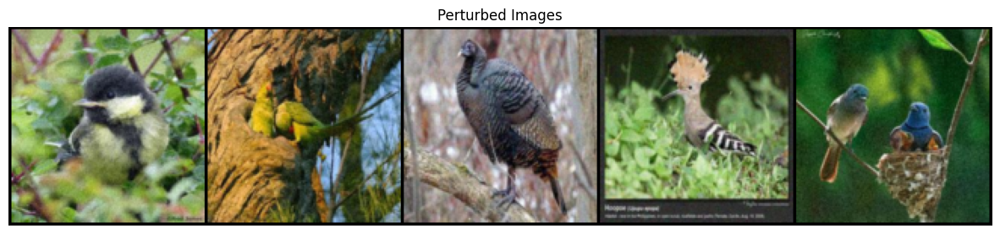

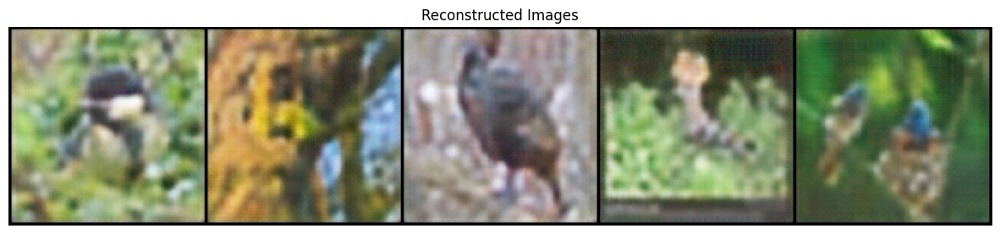

In [29]:
show_images(autoencoder, size)

## Experiment 7

In [30]:
class DenoisingConvAutoencoder(pl.LightningModule):
    def __init__(self):
        super(DenoisingConvAutoencoder, self).__init__()
        self.validation_results = {
            'inputs': [],
            'perturbed': [],
            'outputs': []
        }
        self.train_step_losses = []
        self.val_step_losses = []
        self.train_losses = []
        self.val_losses = []

        # Encoder
        self.encoder = nn.Sequential(
            nn.Conv2d(3, 16, kernel_size=3, stride=1, padding=1),
            nn.BatchNorm2d(16),
            nn.LeakyReLU(0.2),
            nn.Conv2d(16, 32, kernel_size=3, stride=1, padding=1),
            nn.BatchNorm2d(32),
            nn.LeakyReLU(0.2),
            nn.MaxPool2d(2, 2),  # 64x64

            nn.Conv2d(32, 64, kernel_size=3, stride=1, padding=1),
            nn.BatchNorm2d(64),
            nn.LeakyReLU(0.2),
            nn.Conv2d(64, 128, kernel_size=3, stride=1, padding=1),
            nn.BatchNorm2d(128),
            nn.LeakyReLU(0.2),
            nn.MaxPool2d(2, 2),  # 32x32
            nn.Conv2d(128, 128, kernel_size=3, stride=1, padding=1),
            nn.BatchNorm2d(128),
            nn.LeakyReLU(0.2),
            nn.Conv2d(128, 128, kernel_size=3, stride=1, padding=1),
            nn.BatchNorm2d(128),
            nn.LeakyReLU(0.2),
            nn.Conv2d(128, 256, kernel_size=3, stride=1, padding=1),
            nn.BatchNorm2d(256),
            nn.LeakyReLU(0.2),
            nn.MaxPool2d(2, 2),  # 16x16
            nn.Conv2d(256, 256, kernel_size=3, stride=1, padding=1),
            nn.BatchNorm2d(256),
            nn.LeakyReLU(0.2),
            nn.MaxPool2d(2, 2),  # 8x8
        )

        # Decoder
        self.decoder = nn.Sequential(
            nn.ConvTranspose2d(256, 256, kernel_size=3, stride=2, padding=1, output_padding=1),
            nn.BatchNorm2d(256),
            nn.LeakyReLU(0.2),
            nn.ConvTranspose2d(256, 128, kernel_size=3, stride=2, padding=1, output_padding=1),
            nn.BatchNorm2d(128),
            nn.LeakyReLU(0.2),
            nn.Conv2d(128, 128, kernel_size=3, stride=1, padding=1),
            nn.BatchNorm2d(128),
            nn.LeakyReLU(0.2),
            nn.Conv2d(128, 128, kernel_size=3, stride=1, padding=1),
            nn.BatchNorm2d(128),
            nn.LeakyReLU(0.2),
            nn.ConvTranspose2d(128, 64, kernel_size=3, stride=2, padding=1, output_padding=1),
            nn.BatchNorm2d(64),
            nn.LeakyReLU(0.2),
            nn.ConvTranspose2d(64, 32, kernel_size=3, stride=2, padding=1, output_padding=1),
            nn.BatchNorm2d(32),
            nn.LeakyReLU(0.2),
            nn.Conv2d(32, 16, kernel_size=3, stride=1, padding=1),
            nn.BatchNorm2d(16),
            nn.LeakyReLU(0.2),
            nn.Conv2d(16, 3, kernel_size=3, stride=1, padding=1),
            nn.Tanh()
        )

        self.criterion = nn.MSELoss()

    def forward(self, x):
        code = self.encoder(x)
        reconstructed = self.decoder(code)
        return code, reconstructed

    def configure_optimizers(self):
        optimizer = AdamW(self.parameters(), lr=1e-4, weight_decay=1e-3)
        return optimizer

    def training_step(self, train_batch, batch_idx):
        x_noisy, x_clean = train_batch
        _, reconstructed = self.forward(x_noisy)
        loss = self.criterion(x_clean, reconstructed)
        self.log('train/loss', loss, prog_bar=True)
        self.train_step_losses.append(loss.item())
        return loss

    def on_train_epoch_end(self):
        self.train_losses.append(self.train_step_losses[-1])

    def validation_step(self, val_batch, batch_idx):
        x_noisy, x_clean = val_batch
        _, reconstructed = self.forward(x_noisy)
        loss = self.criterion(x_clean, reconstructed)
        self.log('val/loss', loss, prog_bar=True)
        self.val_step_losses.append(loss.item())

        self.validation_results['inputs'] = x_clean
        self.validation_results['perturbed'] = x_noisy
        self.validation_results['outputs'] = reconstructed

        return loss

    def on_train_end(self):
        plt.figure(figsize=(10, 5))
        plt.plot(self.train_losses, label='Training Loss')
        plt.plot(self.val_losses[1:], label='Validation Loss')
        plt.xlabel('Epoch')
        plt.ylabel('Loss')
        plt.title('Training and Validation Loss')
        # plt.legend()
        plt.show()

        torch.save(self.state_dict(), 'denoising_conv_autoencoder_v7.pth')

    def on_validation_epoch_end(self):
        self.val_losses.append(min(self.val_step_losses))

INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
INFO:pytorch_lightning.callbacks.model_summary:
  | Name      | Type       | Params | Mode 
-------------------------------------------------
0 | encoder   | Sequential | 1.3 M  | train
1 | decoder   | Sequential | 1.3 M  | train
2 | criterion | MSELoss    | 0      | train
-------------------------------------------------
2.6 M     Trainable params
0         Non-trainable params
2.6 M     Total params
10.236    Total estimated model params size (MB)


Sanity Checking: |          | 0/? [00:00<?, ?it/s]

Training: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:`Trainer.fit` stopped: `max_epochs=50` reached.


[0.2749760150909424, 0.2749760150909424, 0.20264235138893127, 0.09040343016386032, 0.06477781385183334, 0.04695611447095871, 0.03475124016404152, 0.027771349996328354, 0.022436413913965225, 0.019193409010767937, 0.01575392857193947, 0.01575392857193947, 0.01575392857193947, 0.012663133442401886, 0.012416436336934566, 0.011431380175054073, 0.010846134275197983, 0.010671963915228844, 0.009973379783332348, 0.009973379783332348, 0.009973379783332348, 0.009366359561681747, 0.009163370355963707, 0.009163370355963707, 0.008975643664598465, 0.008975643664598465, 0.008975643664598465, 0.008508512750267982, 0.008508512750267982, 0.008048417046666145, 0.007789733819663525, 0.007673981599509716, 0.007673981599509716, 0.007673981599509716, 0.007461769040673971, 0.007461769040673971, 0.007461769040673971, 0.007461769040673971, 0.007182606495916843, 0.0069231330417096615, 0.0069231330417096615, 0.0068011051043868065, 0.0068011051043868065, 0.0068011051043868065, 0.0068011051043868065, 0.0068011051043

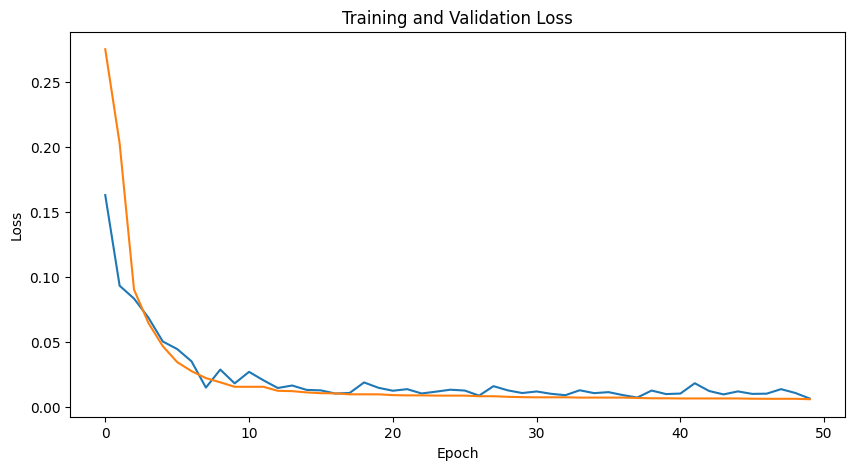

In [31]:
torch.set_float32_matmul_precision('medium')

autoencoder = DenoisingConvAutoencoder()

trainer = pl.Trainer(max_epochs=50)

trainer.fit(autoencoder, train_dataloader, val_dataloader)

<ipython-input-9-fbe845342f23>:17: FutureWarning: `multichannel` is a deprecated argument name for `structural_similarity`. It will be removed in version 1.0. Please use `channel_axis` instead.
  return ssim(image1_np, image2_np, data_range=1.0, multichannel=True, win_size=3, channel_axis=-1)


Average PSNR between clear and perturbed images: 36.02 dB
Average PSNR between clear and reconstructed images: 20.04 dB
Average SSIM between clear and perturbed images: 0.9170
Average SSIM between clear and reconstructed images: 0.4738


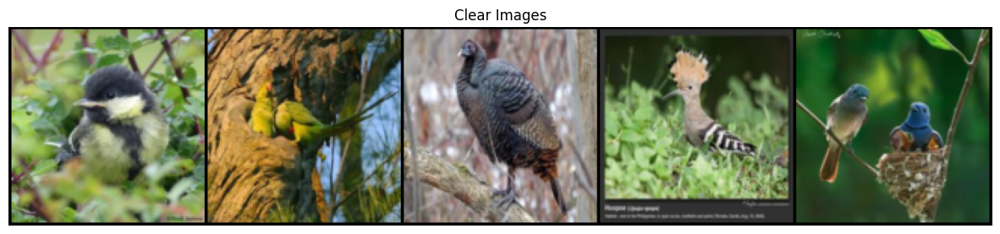

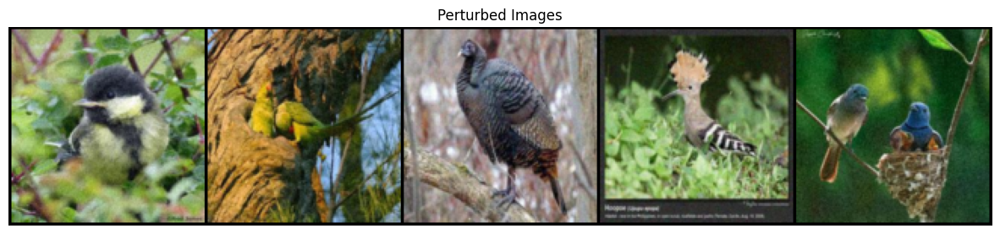

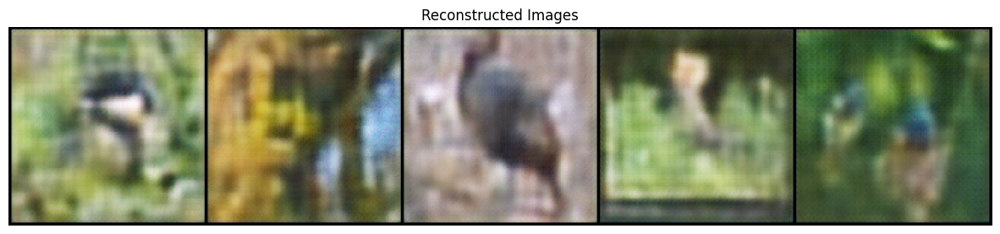

In [32]:
show_images(autoencoder, size)

## Experiment 8

In [33]:
class DenoisingConvAutoencoder(pl.LightningModule):
    def __init__(self):
        super(DenoisingConvAutoencoder, self).__init__()
        self.validation_results = {
            'inputs': [],
            'perturbed': [],
            'outputs': []
        }
        self.train_step_losses = []
        self.val_step_losses = []
        self.train_losses = []
        self.val_losses = []

        # Encoder
        self.encoder = nn.Sequential(
            nn.Conv2d(3, 16, kernel_size=3, stride=1, padding=1),
            nn.BatchNorm2d(16),
            nn.LeakyReLU(0.2),
            nn.Conv2d(16, 32, kernel_size=3, stride=1, padding=1),
            nn.BatchNorm2d(32),
            nn.LeakyReLU(0.2),
            nn.MaxPool2d(2, 2),  # 64x64

            nn.Conv2d(32, 64, kernel_size=3, stride=1, padding=1),
            nn.BatchNorm2d(64),
            nn.LeakyReLU(0.2),
            nn.Conv2d(64, 128, kernel_size=3, stride=1, padding=1),
            nn.BatchNorm2d(128),
            nn.LeakyReLU(0.2),
            nn.MaxPool2d(2, 2),  # 32x32
            nn.Conv2d(128, 128, kernel_size=3, stride=1, padding=1),
            nn.BatchNorm2d(128),
            nn.LeakyReLU(0.2),
            # nn.Conv2d(128, 128, kernel_size=3, stride=1, padding=1),
            # nn.BatchNorm2d(128),
            # nn.LeakyReLU(0.2),
            nn.Conv2d(128, 256, kernel_size=3, stride=1, padding=1),
            nn.BatchNorm2d(256),
            nn.LeakyReLU(0.2),
            # nn.MaxPool2d(2, 2),  # 16x16
            nn.Conv2d(256, 256, kernel_size=3, stride=1, padding=1),
            nn.BatchNorm2d(256),
            nn.LeakyReLU(0.2),
            # nn.MaxPool2d(2, 2),  # 8x8
        )

        # Decoder
        self.decoder = nn.Sequential(
            nn.ConvTranspose2d(256, 256, kernel_size=3, stride=2, padding=1, output_padding=1),
            nn.BatchNorm2d(256),
            nn.LeakyReLU(0.2),
            nn.ConvTranspose2d(256, 128, kernel_size=3, stride=2, padding=1, output_padding=1),
            nn.BatchNorm2d(128),
            nn.LeakyReLU(0.2),
            nn.Conv2d(128, 128, kernel_size=3, stride=1, padding=1),
            nn.BatchNorm2d(128),
            nn.LeakyReLU(0.2),
            # nn.Conv2d(128, 128, kernel_size=3, stride=1, padding=1),
            # nn.BatchNorm2d(128),
            # nn.LeakyReLU(0.2),
            # nn.ConvTranspose2d(128, 64, kernel_size=3, stride=2, padding=1, output_padding=1),
            nn.Conv2d(128, 64, kernel_size=3, stride=1, padding=1),
            nn.BatchNorm2d(64),
            nn.LeakyReLU(0.2),
            # nn.ConvTranspose2d(64, 32, kernel_size=3, stride=2, padding=1, output_padding=1),
            nn.Conv2d(64, 32, kernel_size=3, stride=1, padding=1),
            nn.BatchNorm2d(32),
            nn.LeakyReLU(0.2),
            nn.Conv2d(32, 16, kernel_size=3, stride=1, padding=1),
            nn.BatchNorm2d(16),
            nn.LeakyReLU(0.2),
            nn.Conv2d(16, 3, kernel_size=3, stride=1, padding=1),
            nn.Tanh()
        )

        self.criterion = nn.MSELoss()

    def forward(self, x):
        code = self.encoder(x)
        reconstructed = self.decoder(code)
        return code, reconstructed

    def configure_optimizers(self):
        optimizer = AdamW(self.parameters(), lr=1e-4, weight_decay=1e-3)
        return optimizer

    def training_step(self, train_batch, batch_idx):
        x_noisy, x_clean = train_batch
        _, reconstructed = self.forward(x_noisy)
        loss = self.criterion(x_clean, reconstructed)
        self.log('train/loss', loss, prog_bar=True)
        self.train_step_losses.append(loss.item())
        return loss

    def on_train_epoch_end(self):
        self.train_losses.append(self.train_step_losses[-1])

    def validation_step(self, val_batch, batch_idx):
        x_noisy, x_clean = val_batch
        _, reconstructed = self.forward(x_noisy)
        loss = self.criterion(x_clean, reconstructed)
        self.log('val/loss', loss, prog_bar=True)
        self.val_step_losses.append(loss.item())

        self.validation_results['inputs'] = x_clean
        self.validation_results['perturbed'] = x_noisy
        self.validation_results['outputs'] = reconstructed

        return loss

    def on_train_end(self):
        plt.figure(figsize=(10, 5))
        plt.plot(self.train_losses, label='Training Loss')
        plt.plot(self.val_losses[1:], label='Validation Loss')
        plt.xlabel('Epoch')
        plt.ylabel('Loss')
        plt.title('Training and Validation Loss')
        # plt.legend()
        plt.show()

        torch.save(self.state_dict(), 'denoising_conv_autoencoder_v8.pth')

    def on_validation_epoch_end(self):
        self.val_losses.append(min(self.val_step_losses))

INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
INFO:pytorch_lightning.callbacks.model_summary:
  | Name      | Type       | Params | Mode 
-------------------------------------------------
0 | encoder   | Sequential | 1.1 M  | train
1 | decoder   | Sequential | 1.1 M  | train
2 | criterion | MSELoss    | 0      | train
-------------------------------------------------
2.3 M     Trainable params
0         Non-trainable params
2.3 M     Total params
9.053     Total estimated model params size (MB)


Sanity Checking: |          | 0/? [00:00<?, ?it/s]

Training: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:`Trainer.fit` stopped: `max_epochs=50` reached.



[0.32492244243621826, 0.2780953347682953, 0.17805194854736328, 0.0955183207988739, 0.07663944363594055, 0.04610369727015495, 0.04111089929938316, 0.02501598373055458, 0.02501598373055458, 0.01852818951010704, 0.01852818951010704, 0.01852818951010704, 0.009907655417919159, 0.008955366909503937, 0.008955366909503937, 0.008955366909503937, 0.008753045462071896, 0.006841808557510376, 0.006841808557510376, 0.006728829815983772, 0.006176087539643049, 0.006176087539643049, 0.006176087539643049, 0.005842585116624832, 0.005615889560431242, 0.005615889560431242, 0.005615889560431242, 0.005615889560431242, 0.005615889560431242, 0.005381576716899872, 0.005067434161901474, 0.004331639967858791, 0.004331639967858791, 0.004331639967858791, 0.004049856215715408, 0.003953765146434307, 0.003953765146434307, 0.003696977626532316, 0.003696977626532316, 0.0034502088092267513, 0.0034502088092267513, 0.0034502088092267513, 0.0034110944252461195, 0.0034110944252461195, 0.0034110944252461195, 0.00341109442524

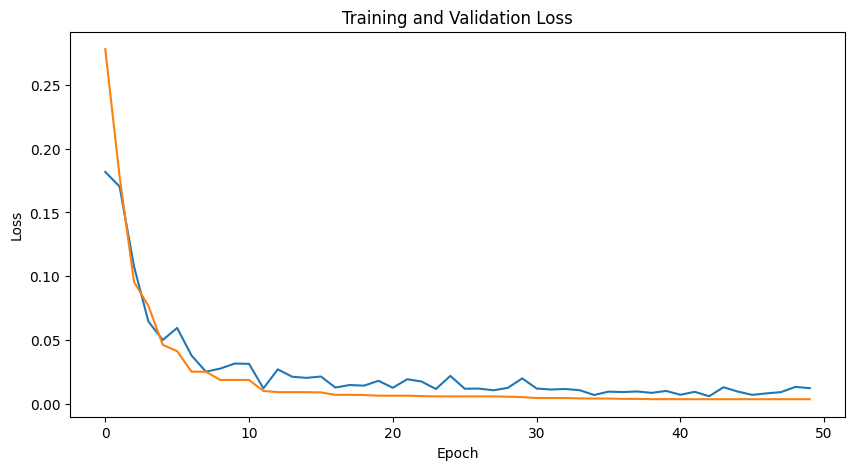

In [34]:
torch.cuda.empty_cache()

torch.set_float32_matmul_precision('medium')

autoencoder = DenoisingConvAutoencoder()

trainer = pl.Trainer(max_epochs=50)

trainer.fit(autoencoder, train_dataloader, val_dataloader)

<ipython-input-9-fbe845342f23>:17: FutureWarning: `multichannel` is a deprecated argument name for `structural_similarity`. It will be removed in version 1.0. Please use `channel_axis` instead.
  return ssim(image1_np, image2_np, data_range=1.0, multichannel=True, win_size=3, channel_axis=-1)


Average PSNR between clear and perturbed images: 36.02 dB
Average PSNR between clear and reconstructed images: 20.51 dB
Average SSIM between clear and perturbed images: 0.9170
Average SSIM between clear and reconstructed images: 0.6245


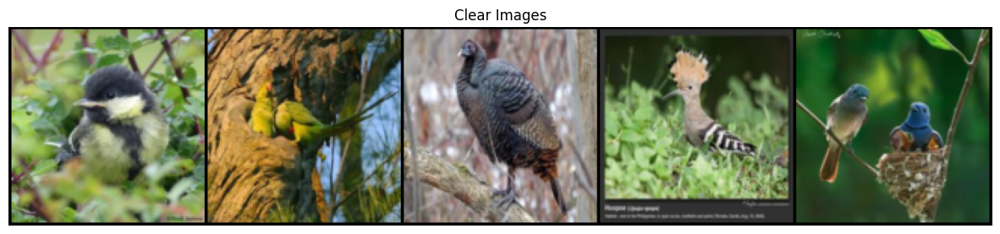

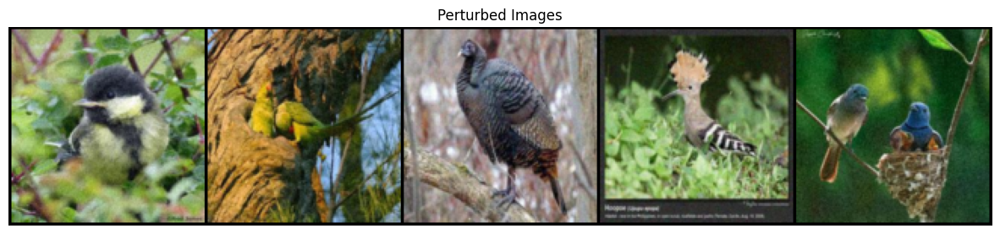

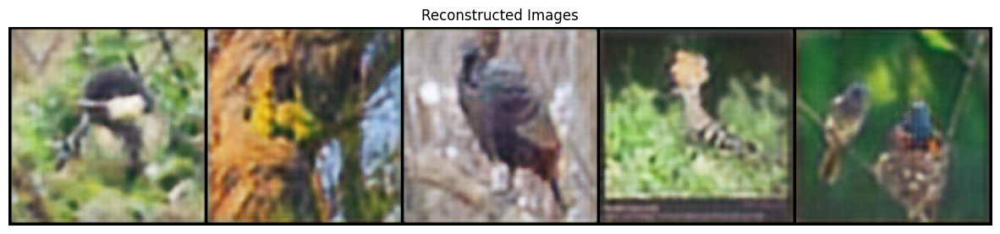

In [35]:
show_images(autoencoder, size)

## Experiment 9

In [36]:
class DenoisingConvAutoencoder(pl.LightningModule):
    def __init__(self):
        super(DenoisingConvAutoencoder, self).__init__()
        self.validation_results = {
            'inputs': [],
            'perturbed': [],
            'outputs': []
        }
        self.train_step_losses = []
        self.val_step_losses = []
        self.train_losses = []
        self.val_losses = []

        # Encoder
        self.encoder = nn.Sequential(
            nn.Conv2d(3, 16, kernel_size=3, stride=1, padding=1),
            nn.BatchNorm2d(16),
            nn.LeakyReLU(0.2),
            nn.Conv2d(16, 32, kernel_size=3, stride=1, padding=1),
            nn.BatchNorm2d(32),
            nn.LeakyReLU(0.2),
            nn.MaxPool2d(2, 2),  # 64x64

            nn.Conv2d(32, 64, kernel_size=3, stride=1, padding=1),
            nn.BatchNorm2d(64),
            nn.LeakyReLU(0.2),
            nn.Conv2d(64, 128, kernel_size=3, stride=1, padding=1),
            nn.BatchNorm2d(128),
            nn.LeakyReLU(0.2),
            nn.Conv2d(128, 128, kernel_size=3, stride=1, padding=1),
            nn.BatchNorm2d(128),
            nn.LeakyReLU(0.2),
            # nn.Conv2d(128, 128, kernel_size=3, stride=1, padding=1),
            # nn.BatchNorm2d(128),
            # nn.LeakyReLU(0.2),
            nn.Conv2d(128, 256, kernel_size=3, stride=1, padding=1),
            nn.BatchNorm2d(256),
            nn.LeakyReLU(0.2),
            nn.MaxPool2d(2, 2),  # 32x32
            # nn.MaxPool2d(2, 2),  # 16x16
            nn.Conv2d(256, 256, kernel_size=3, stride=1, padding=1),
            nn.BatchNorm2d(256),
            nn.LeakyReLU(0.2),
            # nn.MaxPool2d(2, 2),  # 8x8
        )

        # Decoder
        self.decoder = nn.Sequential(
            nn.ConvTranspose2d(256, 256, kernel_size=3, stride=2, padding=1, output_padding=1),
            nn.BatchNorm2d(256),
            nn.LeakyReLU(0.2),
            nn.ConvTranspose2d(256, 128, kernel_size=3, stride=2, padding=1, output_padding=1),
            nn.BatchNorm2d(128),
            nn.LeakyReLU(0.2),
            nn.Conv2d(128, 128, kernel_size=3, stride=1, padding=1),
            nn.BatchNorm2d(128),
            nn.LeakyReLU(0.2),
            # nn.Conv2d(128, 128, kernel_size=3, stride=1, padding=1),
            # nn.BatchNorm2d(128),
            # nn.LeakyReLU(0.2),
            # nn.ConvTranspose2d(128, 64, kernel_size=3, stride=2, padding=1, output_padding=1),
            nn.Conv2d(128, 64, kernel_size=3, stride=1, padding=1),
            nn.BatchNorm2d(64),
            nn.LeakyReLU(0.2),
            # nn.ConvTranspose2d(64, 32, kernel_size=3, stride=2, padding=1, output_padding=1),
            nn.Conv2d(64, 32, kernel_size=3, stride=1, padding=1),
            nn.BatchNorm2d(32),
            nn.LeakyReLU(0.2),
            nn.Conv2d(32, 16, kernel_size=3, stride=1, padding=1),
            nn.BatchNorm2d(16),
            nn.LeakyReLU(0.2),
            nn.Conv2d(16, 3, kernel_size=3, stride=1, padding=1),
            nn.Tanh()
        )

        self.criterion = nn.MSELoss()

    def forward(self, x):
        code = self.encoder(x)
        reconstructed = self.decoder(code)
        return code, reconstructed

    def configure_optimizers(self):
        optimizer = AdamW(self.parameters(), lr=1e-4, weight_decay=1e-3)
        return optimizer

    def training_step(self, train_batch, batch_idx):
        x_noisy, x_clean = train_batch
        _, reconstructed = self.forward(x_noisy)
        loss = self.criterion(x_clean, reconstructed)
        self.log('train/loss', loss, prog_bar=True)
        self.train_step_losses.append(loss.item())
        return loss

    def on_train_epoch_end(self):
        self.train_losses.append(self.train_step_losses[-1])

    def validation_step(self, val_batch, batch_idx):
        x_noisy, x_clean = val_batch
        _, reconstructed = self.forward(x_noisy)
        loss = self.criterion(x_clean, reconstructed)
        self.log('val/loss', loss, prog_bar=True)
        self.val_step_losses.append(loss.item())

        self.validation_results['inputs'] = x_clean
        self.validation_results['perturbed'] = x_noisy
        self.validation_results['outputs'] = reconstructed

        return loss

    def on_train_end(self):
        plt.figure(figsize=(10, 5))
        plt.plot(self.train_losses, label='Training Loss')
        plt.plot(self.val_losses[1:], label='Validation Loss')
        plt.xlabel('Epoch')
        plt.ylabel('Loss')
        plt.title('Training and Validation Loss')
        # plt.legend()
        plt.show()

        torch.save(self.state_dict(), 'denoising_conv_autoencoder_v9.pth')

    def on_validation_epoch_end(self):
        self.val_losses.append(min(self.val_step_losses))

INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
INFO:pytorch_lightning.callbacks.model_summary:
  | Name      | Type       | Params | Mode 
-------------------------------------------------
0 | encoder   | Sequential | 1.1 M  | train
1 | decoder   | Sequential | 1.1 M  | train
2 | criterion | MSELoss    | 0      | train
-------------------------------------------------
2.3 M     Trainable params
0         Non-trainable params
2.3 M     Total params
9.053     Total estimated model params size (MB)


Sanity Checking: |          | 0/? [00:00<?, ?it/s]

Training: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:`Trainer.fit` stopped: `max_epochs=50` reached.



[0.2618536651134491, 0.17726387083530426, 0.08569217473268509, 0.03556978330016136, 0.024969354271888733, 0.022104540839791298, 0.014350132085382938, 0.009942694567143917, 0.007043313235044479, 0.0059371767565608025, 0.00527481734752655, 0.00527481734752655, 0.004057047422975302, 0.004057047422975302, 0.0038568226154893637, 0.0038568226154893637, 0.0034378478303551674, 0.0033851235639303923, 0.0033851235639303923, 0.0033851235639303923, 0.0032513863407075405, 0.0031459666788578033, 0.00280139222741127, 0.00280139222741127, 0.00280139222741127, 0.00280139222741127, 0.00280139222741127, 0.0024980956222862005, 0.0024980956222862005, 0.0024980956222862005, 0.0024980956222862005, 0.0024980956222862005, 0.0024980956222862005, 0.002339540049433708, 0.0022236276417970657, 0.0022236276417970657, 0.0022236276417970657, 0.0022236276417970657, 0.0021309161093086004, 0.0021309161093086004, 0.0021309161093086004, 0.0021309161093086004, 0.002127475803717971, 0.002127475803717971, 0.00197512004524469

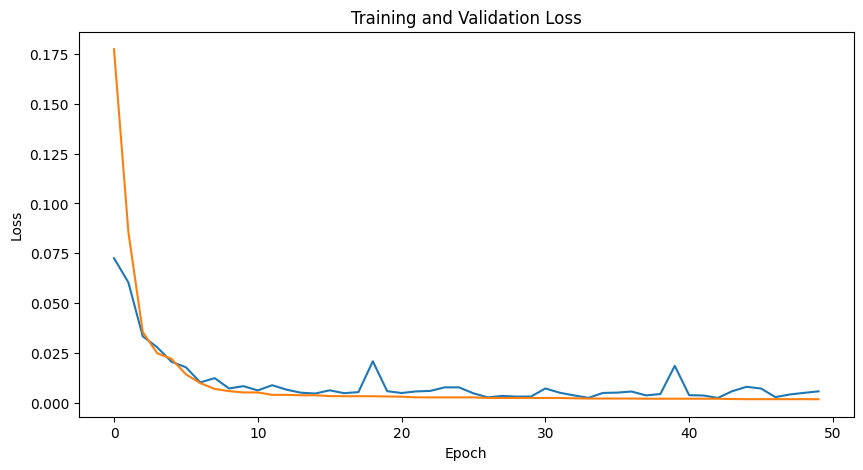

In [37]:
torch.cuda.empty_cache()

torch.set_float32_matmul_precision('medium')

autoencoder = DenoisingConvAutoencoder()

trainer = pl.Trainer(max_epochs=50)

trainer.fit(autoencoder, train_dataloader, val_dataloader)

<ipython-input-9-fbe845342f23>:17: FutureWarning: `multichannel` is a deprecated argument name for `structural_similarity`. It will be removed in version 1.0. Please use `channel_axis` instead.
  return ssim(image1_np, image2_np, data_range=1.0, multichannel=True, win_size=3, channel_axis=-1)


Average PSNR between clear and perturbed images: 36.02 dB
Average PSNR between clear and reconstructed images: 23.29 dB
Average SSIM between clear and perturbed images: 0.9170
Average SSIM between clear and reconstructed images: 0.7061


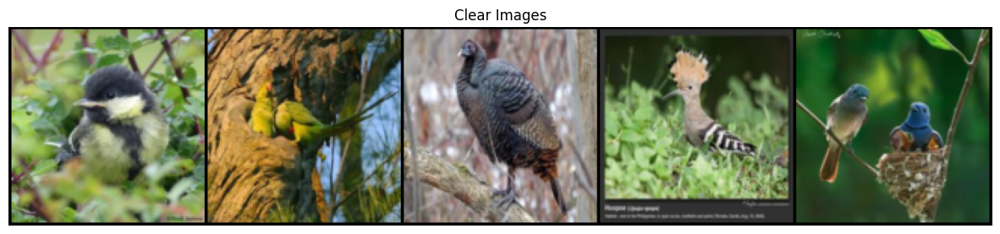

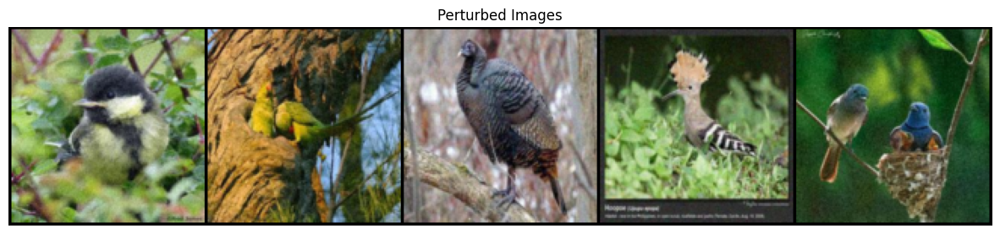

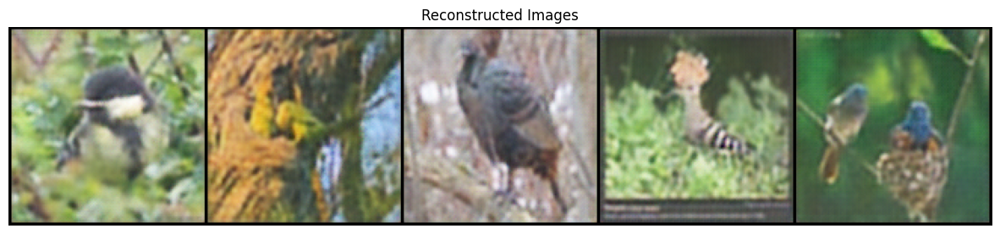

In [38]:
show_images(autoencoder, size)

## Experiment 10

In [39]:
class DenoisingConvAutoencoder(pl.LightningModule):
    def __init__(self):
        super(DenoisingConvAutoencoder, self).__init__()
        self.validation_results = {
            'inputs': [],
            'perturbed': [],
            'outputs': []
        }
        self.train_step_losses = []
        self.val_step_losses = []
        self.train_losses = []
        self.val_losses = []

        # Encoder
        self.encoder = nn.Sequential(
            nn.Conv2d(3, 16, kernel_size=7, stride=1, padding=4),
            nn.BatchNorm2d(16),
            nn.LeakyReLU(0.2),
            nn.Conv2d(16, 32, kernel_size=5, stride=1, padding=2),
            nn.BatchNorm2d(32),
            nn.LeakyReLU(0.2),
            nn.MaxPool2d(2, 2),  # 64x64

            nn.Conv2d(32, 64, kernel_size=3, stride=1, padding=1),
            nn.BatchNorm2d(64),
            nn.LeakyReLU(0.2),
            nn.Conv2d(64, 128, kernel_size=3, stride=1, padding=1),
            nn.BatchNorm2d(128),
            nn.LeakyReLU(0.2),
            nn.Conv2d(128, 128, kernel_size=3, stride=1, padding=1),
            nn.BatchNorm2d(128),
            nn.LeakyReLU(0.2),
            # nn.Conv2d(128, 128, kernel_size=3, stride=1, padding=1),
            # nn.BatchNorm2d(128),
            # nn.LeakyReLU(0.2),
            nn.Conv2d(128, 256, kernel_size=3, stride=1, padding=1),
            nn.BatchNorm2d(256),
            nn.LeakyReLU(0.2),
            nn.MaxPool2d(2, 2),  # 32x32
            # nn.MaxPool2d(2, 2),  # 16x16
            nn.Conv2d(256, 256, kernel_size=3, stride=1, padding=1),
            nn.BatchNorm2d(256),
            nn.LeakyReLU(0.2),
            # nn.MaxPool2d(2, 2),  # 8x8
        )

        # Decoder
        self.decoder = nn.Sequential(
            nn.ConvTranspose2d(256, 256, kernel_size=3, stride=2, padding=1, output_padding=1),
            nn.BatchNorm2d(256),
            nn.LeakyReLU(0.2),
            nn.ConvTranspose2d(256, 128, kernel_size=3, stride=2, padding=1, output_padding=1),
            nn.BatchNorm2d(128),
            nn.LeakyReLU(0.2),
            nn.Conv2d(128, 128, kernel_size=3, stride=1, padding=1),
            nn.BatchNorm2d(128),
            nn.LeakyReLU(0.2),
            # nn.Conv2d(128, 128, kernel_size=3, stride=1, padding=1),
            # nn.BatchNorm2d(128),
            # nn.LeakyReLU(0.2),
            # nn.ConvTranspose2d(128, 64, kernel_size=3, stride=2, padding=1, output_padding=1),
            nn.Conv2d(128, 64, kernel_size=3, stride=1, padding=1),
            nn.BatchNorm2d(64),
            nn.LeakyReLU(0.2),
            # nn.ConvTranspose2d(64, 32, kernel_size=3, stride=2, padding=1, output_padding=1),
            nn.Conv2d(64, 32, kernel_size=3, stride=1, padding=1),
            nn.BatchNorm2d(32),
            nn.LeakyReLU(0.2),
            nn.Conv2d(32, 16, kernel_size=5, stride=1, padding=3),
            nn.BatchNorm2d(16),
            nn.LeakyReLU(0.2),
            nn.Conv2d(16, 3, kernel_size=7, stride=1, padding=2),
            nn.Tanh()
        )

        self.criterion = nn.MSELoss()

    def forward(self, x):
        code = self.encoder(x)
        reconstructed = self.decoder(code)
        return code, reconstructed

    def configure_optimizers(self):
        optimizer = AdamW(self.parameters(), lr=1e-4, weight_decay=1e-3)
        return optimizer

    def training_step(self, train_batch, batch_idx):
        x_noisy, x_clean = train_batch
        _, reconstructed = self.forward(x_noisy)
        loss = self.criterion(x_clean, reconstructed)
        self.log('train/loss', loss, prog_bar=True)
        self.train_step_losses.append(loss.item())
        return loss

    def on_train_epoch_end(self):
        self.train_losses.append(self.train_step_losses[-1])

    def validation_step(self, val_batch, batch_idx):
        x_noisy, x_clean = val_batch
        _, reconstructed = self.forward(x_noisy)
        loss = self.criterion(x_clean, reconstructed)
        self.log('val/loss', loss, prog_bar=True)
        self.val_step_losses.append(loss.item())

        self.validation_results['inputs'] = x_clean
        self.validation_results['perturbed'] = x_noisy
        self.validation_results['outputs'] = reconstructed

        return loss

    def on_train_end(self):
        plt.figure(figsize=(10, 5))
        plt.plot(self.train_losses, label='Training Loss')
        plt.plot(self.val_losses[1:], label='Validation Loss')
        plt.xlabel('Epoch')
        plt.ylabel('Loss')
        plt.title('Training and Validation Loss')
        # plt.legend()
        plt.show()

        torch.save(self.state_dict(), 'denoising_conv_autoencoder_v10.pth')

    def on_validation_epoch_end(self):
        self.val_losses.append(min(self.val_step_losses))

INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
INFO:pytorch_lightning.callbacks.model_summary:
  | Name      | Type       | Params | Mode 
-------------------------------------------------
0 | encoder   | Sequential | 1.1 M  | train
1 | decoder   | Sequential | 1.1 M  | train
2 | criterion | MSELoss    | 0      | train
-------------------------------------------------
2.3 M     Trainable params
0         Non-trainable params
2.3 M     Total params
9.134     Total estimated model params size (MB)


Sanity Checking: |          | 0/? [00:00<?, ?it/s]

Training: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:`Trainer.fit` stopped: `max_epochs=50` reached.



[0.26777034997940063, 0.14944510161876678, 0.02719186618924141, 0.009885880164802074, 0.007946808822453022, 0.007088813465088606, 0.0059186420403420925, 0.005502124782651663, 0.005276085343211889, 0.005276085343211889, 0.004734881222248077, 0.004684478975832462, 0.004587992560118437, 0.004245273768901825, 0.004245273768901825, 0.003666004166007042, 0.003666004166007042, 0.003458371851593256, 0.003458371851593256, 0.003458371851593256, 0.003432963974773884, 0.003189516719430685, 0.0030879878904670477, 0.0030879878904670477, 0.0030879878904670477, 0.0030879878904670477, 0.0030879878904670477, 0.0030760811641812325, 0.00287800095975399, 0.00287800095975399, 0.00287800095975399, 0.002859516767784953, 0.002812271937727928, 0.002668568631634116, 0.0025987625122070312, 0.0025987625122070312, 0.0025987625122070312, 0.0023971793707460165, 0.0023971793707460165, 0.0023971793707460165, 0.0023971793707460165, 0.0023971793707460165, 0.0023971793707460165, 0.0023971793707460165, 0.00239717937074601

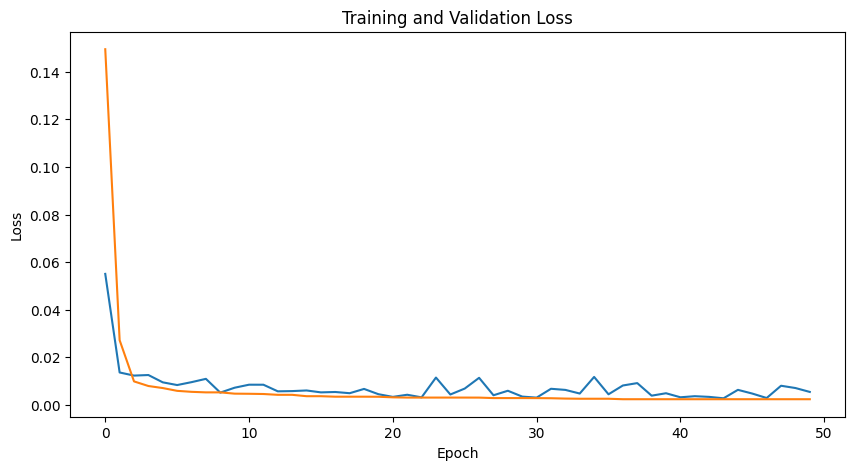

In [40]:
torch.cuda.empty_cache()

torch.set_float32_matmul_precision('medium')

autoencoder = DenoisingConvAutoencoder()

# # Configura il trainer
trainer = pl.Trainer(max_epochs=50)  # Specifica il numero di epoch desiderati

# Continua l'addestramento
trainer.fit(autoencoder, train_dataloader, val_dataloader)

<ipython-input-9-fbe845342f23>:17: FutureWarning: `multichannel` is a deprecated argument name for `structural_similarity`. It will be removed in version 1.0. Please use `channel_axis` instead.
  return ssim(image1_np, image2_np, data_range=1.0, multichannel=True, win_size=3, channel_axis=-1)


Average PSNR between clear and perturbed images: 36.02 dB
Average PSNR between clear and reconstructed images: 21.32 dB
Average SSIM between clear and perturbed images: 0.9170
Average SSIM between clear and reconstructed images: 0.6727


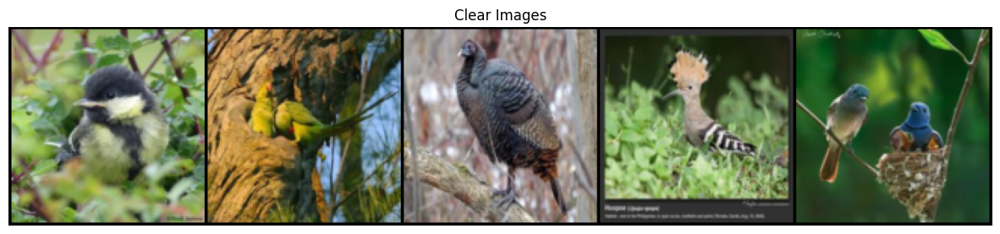

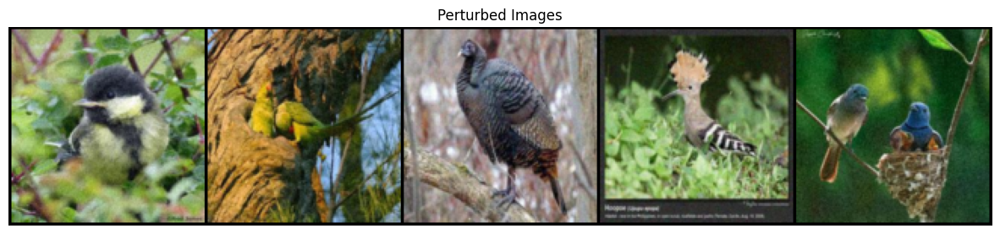

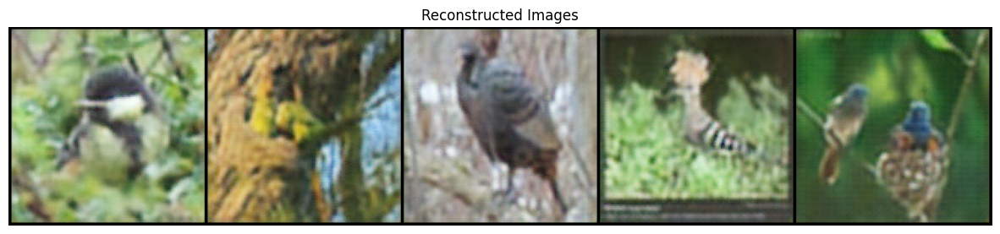

In [41]:
show_images(autoencoder,size)